## Telecom Churn Case Study

#### Using Logistic Regression PCA, RFE

#### Problem Statement
Business problem overview
In the telecom industry, customers are able to choose from multiple service providers and actively switch from one operator to another. In this highly competitive market, the telecommunications industry experiences an average of 15-25% annual churn rate. Given the fact that it costs  5-10 times more to acquire a new customer than to retain an existing one, customer retention has now become even more important than customer acquisition.
For many incumbent operators, retaining high profitable customers is the number one business goal.
To reduce customer churn, telecom companies need to predict which customers are at high risk of churn.
In this project, we will analyse customer-level data of a leading telecom firm, build predictive models to identify customers at high risk of churn and identify the main indicators of churn.


#### Definitions of churn
There are various ways to define churn, such as:
* Revenue-based churn: Customers who have not utilised any revenue-generating facilities such as mobile internet, outgoing calls, SMS etc. over a given period of time. One could also use aggregate metrics such as ‘customers who have generated less than INR 4 per month in total/average/median revenue’.The main shortcoming of this definition is that there are customers who only receive calls/SMSes from their wage-earning counterparts, i.e. they don’t generate revenue but use the services. For example, many users in rural areas only receive calls from their wage-earning siblings in urban areas.
 
* Usage-based churn: Customers who have not done any usage, either incoming or outgoing - in terms of calls, internet etc. over a period of time.A potential shortcoming of this definition is that when the customer has stopped using the services for a while, it may be too late to take any corrective actions to retain them. For e.g., if you define churn based on a ‘two-months zero usage’ period, predicting churn could be useless since by that time the customer would have already switched to another operator.
 
In this project, we will use the usage-based definition to define churn.
 
* High-value churn
In the Indian and the Southeast Asian market, approximately 80% of revenue comes from the top 20% customers (called high-value customers). Thus, if we can reduce churn of the high-value customers, we will be able to reduce significant revenue leakage.
 
In this project, we will define high-value customers based on a certain metric (mentioned later below) and predict churn only on high-value customers.
 

#### Steps Performed in the Complete Model Making:
* 1. Inmporting necessary Libraries</br>

* 2. Reading And Analysing Data.</br>

* 3. Data Preparation</br>
       * 3.1. Derive New Features.</br>
            * 1. Introducing meaningfull column names <br/>
            * 2. Filter high-value customers</br>
            * 3. Tag churners and remove attributes of the churn phase.</br>
            * 4. DataType Conversion Treatment</br>
            * 5. Mullticolinearity Treatment</br>
            * 6. Unique Value Treatment.</br>
            * 7. Missing Value Treatment.</br>
            * 8. Outlier Treatment</br>
                    3.1.8.1. Univariate Analysis.<br/>
                    3.1.8.2. Bivariate Analysis.<br/>
                    3.1.8.3. Multivariate Analysis.<br/>
        * 3.2. Comparative Study on Month 6,7,8
        * 3.3. Derive some new feautres from the existing columns.</br>
        * 3.4. Churn Vs Other Important Features Plots EDA.

* 4. Train and Test Split.

* 5. Features Scaling.
       * 5.1 Class Imbalance Using SMOTE Technique To make it Balanced Then Scaled.

* 6. Building Logistic Regression Models.

* 7. Feature Selection Using RFE With Logistic Regression

* 8. Plotting the ROC Curve

* 9. Finding Optimal Cutoff Point

* 10. Test Data Predictions.

* 11. PCA
       * 11.1 Train Test Split Before doing PCA
       * 11.2 Class Imbalance Using SMOTE Technique To make it Balanced and Then Scaled

* 12. Logistic Regression with PCA
       *  12.1 Hyper turning to increse the accuracy of our PCA model with Number of components selection
       *  12.2 Scree plot to check the variance explained by different PCAs
       *  12.3 Checking with 10 components
       
* 13. Building PairPlot with 10 PCA Components.

* 14. Accuracy and other Metrics Scores for using PCA with Logistic Regression

* 15. Key Findings.
       * 15.1. List Of Users who can Churn.
       * 15.2. Comparative Study on Metrics we found on both RFE and PCA using Logictic Regression

* 16. Conclusion or Insights On Model.
        
        
        

### Step 1: Importing Libraries

In [1]:
# lets import the required libraries and packages
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.model_selection import KFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE
from collections import Counter
import statsmodels.api as sm
from sklearn.metrics import accuracy_score,f1_score,recall_score,confusion_matrix,classification_report,precision_score,roc_curve

In [2]:
# Importing all datasets
telecom_data = pd.read_csv("telecom_churn_data.csv")

### Step 2: Reading And Analysing Data

In [3]:
# Let's see the head of our master dataset
telecom_data.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,...,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
0,7000842753,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,197.385,...,0,1.0,1.0,1.0,NaN,968,30.4,0.0,101.20,3.58
1,7001865778,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,34.047,...,0,NaN,1.0,1.0,NaN,1006,0.0,0.0,0.00,0.00
2,7001625959,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,167.690,...,0,NaN,NaN,NaN,1.0,1103,0.0,0.0,4.17,0.00
3,7001204172,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,221.338,...,0,NaN,NaN,NaN,NaN,2491,0.0,0.0,0.00,0.00
4,7000142493,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,261.636,...,0,0.0,NaN,NaN,NaN,1526,0.0,0.0,0.00,0.00


In [4]:
# Let's check the dimensions of the dataframe
telecom_data.shape

(99999, 226)

In [5]:
# let's look at the statistical aspects of the dataframe
telecom_data.describe()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,...,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
count,9.999900e+04,99999.0,98981.0,98981.0,98981.0,99999.000000,99999.000000,99999.000000,99999.000000,96062.000000,...,99999.000000,25153.000000,25571.000000,26339.000000,25922.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000
mean,7.001207e+09,109.0,0.0,0.0,0.0,282.987358,278.536648,279.154731,261.645069,132.395875,...,0.084581,0.914404,0.908764,0.890808,0.860968,1219.854749,68.170248,66.839062,60.021204,3.299373
std,6.956694e+05,0.0,0.0,0.0,0.0,328.439770,338.156291,344.474791,341.998630,297.207406,...,0.650457,0.279772,0.287950,0.311885,0.345987,954.733842,267.580450,271.201856,253.938223,32.408353
min,7.000000e+09,109.0,0.0,0.0,0.0,-2258.709000,-2014.045000,-945.808000,-1899.505000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,180.000000,0.000000,0.000000,0.000000,0.000000
25%,7.000606e+09,109.0,0.0,0.0,0.0,93.411500,86.980500,84.126000,62.685000,7.380000,...,0.000000,1.000000,1.000000,1.000000,1.000000,467.000000,0.000000,0.000000,0.000000,0.000000
50%,7.001205e+09,109.0,0.0,0.0,0.0,197.704000,191.640000,192.080000,176.849000,34.310000,...,0.000000,1.000000,1.000000,1.000000,1.000000,863.000000,0.000000,0.000000,0.000000,0.000000
75%,7.001812e+09,109.0,0.0,0.0,0.0,371.060000,365.344500,369.370500,353.466500,118.740000,...,0.000000,1.000000,1.000000,1.000000,1.000000,1807.500000,0.000000,0.000000,0.000000,0.000000
max,7.002411e+09,109.0,0.0,0.0,0.0,27731.088000,35145.834000,33543.624000,38805.617000,7376.710000,...,49.000000,1.000000,1.000000,1.000000,1.000000,4337.000000,12916.220000,9165.600000,11166.210000,2618.570000


In [6]:
# Let's see the type of each column
telecom_data.info(verbose=1)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Data columns (total 226 columns):
 #    Column                    Dtype  
---   ------                    -----  
 0    mobile_number             int64  
 1    circle_id                 int64  
 2    loc_og_t2o_mou            float64
 3    std_og_t2o_mou            float64
 4    loc_ic_t2o_mou            float64
 5    last_date_of_month_6      object 
 6    last_date_of_month_7      object 
 7    last_date_of_month_8      object 
 8    last_date_of_month_9      object 
 9    arpu_6                    float64
 10   arpu_7                    float64
 11   arpu_8                    float64
 12   arpu_9                    float64
 13   onnet_mou_6               float64
 14   onnet_mou_7               float64
 15   onnet_mou_8               float64
 16   onnet_mou_9               float64
 17   offnet_mou_6              float64
 18   offnet_mou_7              float64
 19   offnet_mou_8              float64
 20   offn

#### Understanding the business objective and the data
The dataset contains customer-level information for a span of four consecutive months - June, July, August and September. The months are encoded as 6, 7, 8 and 9, respectively. 
The business objective is to predict the churn in the last (i.e. the ninth) month using the data (features) from the first three months. To do this task well, understanding the typical customer behaviour during churn will be helpful.

# Step 3 Data Preparation
The following data preparation steps are crucial for this problem:
 
### 3.1. Derive new features
This is one of the most important parts of data preparation since good features are often the differentiators between good and bad models. Use your business understanding to derive features you think could be important indicators of churn.

#### In churn prediction, we assume that there are three phases of customer lifecycle :<br/>
** The ‘good’ phase: In this phase, the customer is happy with the service and behaves as usual.<br/>
** The ‘action’ phase: The customer experience starts to sore in this phase, for e.g. he/she gets a compelling offer from a  competitor, faces unjust charges, becomes unhappy with service quality etc. In this phase, the customer usually shows different behaviour than the ‘good’ months. Also, it is crucial to identify high-churn-risk customers in this phase, since some corrective actions can be taken at this point (such as matching the competitor’s offer/improving the service quality etc.)
<br/>
** The ‘churn’ phase: In this phase, the customer is said to have churned. You define churn based on this phase. Also, it is important to note that at the time of prediction (i.e. the action months), this data is not available to you for prediction. Thus, after tagging churn as 1/0 based on this phase, you discard all data corresponding to this phase.

 


#### 3.1.1 Introducing meaningfull column names

In [7]:
# lets find out total amount spent by customers on data recharge,we have two colums available to find this out 
# first column is av_rech_amt_data_x (x represents month here, would be either 6 or 7 or 8)
# second column is total_rech_data_x (x represnts month here, would be either 6 or 7 or 8)
# lets introduce a new column total_rech_data_amt_x which can be calculated as av_rech_amt_data_x * total_rech_data_x

telecom_data['total_rech_data_amt_6'] = telecom_data['av_rech_amt_data_6'] * telecom_data['total_rech_data_6']
telecom_data['total_rech_data_amt_7'] = telecom_data['av_rech_amt_data_7'] * telecom_data['total_rech_data_7']
telecom_data['total_rech_data_amt_8'] = telecom_data['av_rech_amt_data_8'] * telecom_data['total_rech_data_8']
telecom_data['total_rech_data_amt_9'] = telecom_data['av_rech_amt_data_9'] * telecom_data['total_rech_data_9']

# now we dont need columns av_rech_amt_data_x,total_rech_data_x (x = 6/7/8) , lets drop them
telecom_data.drop(['total_rech_data_6',
                   'total_rech_data_7',
                   'total_rech_data_8',
                   'total_rech_data_9',
                   'av_rech_amt_data_6',
                   'av_rech_amt_data_7',
                   'av_rech_amt_data_8',
                   'av_rech_amt_data_9'],axis = 1,inplace = True)

### 3.1.2. Filter high-value customers
As mentioned above, you need to predict churn only for the high-value customers. Define high-value customers as follows: Those who have recharged with an amount more than or equal to X, where X is the 70th percentile of the average recharge amount in the first two months (the good phase).
 


In [8]:
# High-value customers : Those who have recharged with an amount more than or equal to X, where X is the 70th percentile of 
# the average recharge amount in the first two months (the good phase)
# lets dervie features to extract high value customers
# lets find out the average recharge done in the first two months(june & july) - the good phase
# total amount spend would be the sum of total data recharge done & total call/sms recharges
telecom_av_rech_6n7 = (telecom_data['total_rech_amt_6'].fillna(0) + 
                       telecom_data['total_rech_amt_7'].fillna(0) + 
                       telecom_data['total_rech_data_amt_6'].fillna(0) + 
                       telecom_data['total_rech_data_amt_7'].fillna(0)) /2

In [9]:
# take 70 percentile of the calculated average amount
percentile_70_6n7 = np.percentile(telecom_av_rech_6n7, 70.0)
print("70 percentile is : ", percentile_70_6n7)

# fitler the given data set based on 70th percentile
telData = telecom_data[telecom_av_rech_6n7 >= percentile_70_6n7]
telData

70 percentile is :  478.0


,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,...,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,total_rech_data_amt_6,total_rech_data_amt_7,total_rech_data_amt_8,total_rech_data_amt_9
0,7000842753,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,197.385,...,NaN,968,30.40,0.00,101.20,3.58,252.0,252.0,252.0,NaN
7,7000701601,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,1069.180,...,NaN,802,57.74,19.38,18.74,0.00,NaN,NaN,NaN,NaN
8,7001524846,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,378.721,...,NaN,315,21.03,910.65,122.16,0.00,NaN,354.0,207.0,NaN
21,7002124215,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,514.453,...,NaN,720,0.00,0.00,0.00,0.00,NaN,NaN,NaN,NaN
23,7000887461,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,74.350,...,1.0,604,40.45,51.86,0.00,0.00,NaN,712.0,540.0,252.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99981,7000630859,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,384.316,...,NaN,473,1100.43,619.59,668.05,0.33,252.0,252.0,252.0,NaN
99984,7000661676,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,328.594,...,1.0,820,0.00,0.00,0.00,0.00,154.0,484.0,585.0,6648.0
99986,7001729035,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,644.973,...,1.0,2696,497.45,598.67,604.08,0.00,17.0,14.0,25.0,25.0
99988,7002111859,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,312.558,...,1.0,328,104.73,0.00,0.00,0.00,NaN,154.0,154.0,154.0


### 3.1.3. Tag churners and remove attributes of the churn phase
Now tag the churned customers (churn=1, else 0) based on the fourth month as follows: Those who have not made any calls (either incoming or outgoing) AND have not used mobile internet even once in the churn phase. The attributes you need to use to tag churners are:<br/>
•	total_ic_mou_9<br/>
•	total_og_mou_9<br/>
•	vol_2g_mb_9<br/>
•	vol_3g_mb_9<br/>


In [10]:
# lets introduce a new column "churn", values would be either 1 (churn) or 0 (non-churn) for 9 month

telData['churn'] = np.where(telData[['total_ic_mou_9','total_og_mou_9','vol_2g_mb_9','vol_3g_mb_9']].sum(axis=1) == 0, 1,0)
telData.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,...,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,total_rech_data_amt_6,total_rech_data_amt_7,total_rech_data_amt_8,total_rech_data_amt_9,churn
0,7000842753,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,197.385,...,968,30.40,0.00,101.20,3.58,252.0,252.0,252.0,NaN,1
7,7000701601,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,1069.180,...,802,57.74,19.38,18.74,0.00,NaN,NaN,NaN,NaN,1
8,7001524846,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,378.721,...,315,21.03,910.65,122.16,0.00,NaN,354.0,207.0,NaN,0
21,7002124215,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,514.453,...,720,0.00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,0
23,7000887461,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,74.350,...,604,40.45,51.86,0.00,0.00,NaN,712.0,540.0,252.0,0


#### After tagging churners, remove all the attributes corresponding to the churn phase (all attributes having ‘ _9’, etc. in their names).

In [11]:
# Now we will delete 9th month columns because we would predict churn/non-churn later based on data from the 1st 3 months
cols_to_drop = [col for col in telData.columns if '_9' in col]
print(cols_to_drop)

telData.drop(cols_to_drop, axis=1, inplace=True)

telData.shape

['last_date_of_month_9', 'arpu_9', 'onnet_mou_9', 'offnet_mou_9', 'roam_ic_mou_9', 'roam_og_mou_9', 'loc_og_t2t_mou_9', 'loc_og_t2m_mou_9', 'loc_og_t2f_mou_9', 'loc_og_t2c_mou_9', 'loc_og_mou_9', 'std_og_t2t_mou_9', 'std_og_t2m_mou_9', 'std_og_t2f_mou_9', 'std_og_t2c_mou_9', 'std_og_mou_9', 'isd_og_mou_9', 'spl_og_mou_9', 'og_others_9', 'total_og_mou_9', 'loc_ic_t2t_mou_9', 'loc_ic_t2m_mou_9', 'loc_ic_t2f_mou_9', 'loc_ic_mou_9', 'std_ic_t2t_mou_9', 'std_ic_t2m_mou_9', 'std_ic_t2f_mou_9', 'std_ic_t2o_mou_9', 'std_ic_mou_9', 'total_ic_mou_9', 'spl_ic_mou_9', 'isd_ic_mou_9', 'ic_others_9', 'total_rech_num_9', 'total_rech_amt_9', 'max_rech_amt_9', 'date_of_last_rech_9', 'last_day_rch_amt_9', 'date_of_last_rech_data_9', 'max_rech_data_9', 'count_rech_2g_9', 'count_rech_3g_9', 'vol_2g_mb_9', 'vol_3g_mb_9', 'arpu_3g_9', 'arpu_2g_9', 'night_pck_user_9', 'monthly_2g_9', 'sachet_2g_9', 'monthly_3g_9', 'sachet_3g_9', 'fb_user_9', 'total_rech_data_amt_9']


(30001, 170)

### 3.1.4 DataType Conversion Treatment

In [12]:
telData.info(verbose=1)

<class 'pandas.core.frame.DataFrame'>
Index: 30001 entries, 0 to 99997
Data columns (total 170 columns):
 #    Column                    Dtype  
---   ------                    -----  
 0    mobile_number             int64  
 1    circle_id                 int64  
 2    loc_og_t2o_mou            float64
 3    std_og_t2o_mou            float64
 4    loc_ic_t2o_mou            float64
 5    last_date_of_month_6      object 
 6    last_date_of_month_7      object 
 7    last_date_of_month_8      object 
 8    arpu_6                    float64
 9    arpu_7                    float64
 10   arpu_8                    float64
 11   onnet_mou_6               float64
 12   onnet_mou_7               float64
 13   onnet_mou_8               float64
 14   offnet_mou_6              float64
 15   offnet_mou_7              float64
 16   offnet_mou_8              float64
 17   roam_ic_mou_6             float64
 18   roam_ic_mou_7             float64
 19   roam_ic_mou_8             float64
 20   roam_og_m

In [13]:
# lets check for columns that can be changed to integers, floats or date types
object_col_data = telData.select_dtypes(include=['object'])
print(object_col_data.iloc[0])

last_date_of_month_6        6/30/2014
last_date_of_month_7        7/31/2014
last_date_of_month_8        8/31/2014
date_of_last_rech_6         6/21/2014
date_of_last_rech_7         7/16/2014
date_of_last_rech_8          8/8/2014
date_of_last_rech_data_6    6/21/2014
date_of_last_rech_data_7    7/16/2014
date_of_last_rech_data_8     8/8/2014
Name: 0, dtype: object


In [14]:
# convert to datetime
for col in object_col_data.columns:
    telData[col] = pd.to_datetime(telData[col])
telData.shape

(30001, 170)

### 3.1.5 Mullticolinearity Treatment

In [15]:
# lets check the correlation amongst the features, drop the highly correlated ones
cor = telData.corr()
cor

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,arpu_6,arpu_7,...,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,total_rech_data_amt_6,total_rech_data_amt_7,total_rech_data_amt_8,churn
mobile_number,1.000000,NaN,NaN,NaN,NaN,NaN,-0.001167,-0.001696,0.033944,0.029496,...,-0.040233,0.315694,-0.032058,-0.028015,-0.037881,-0.007521,-0.019827,-0.020681,-0.010648,-0.030100
circle_id,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
loc_og_t2o_mou,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std_og_t2o_mou,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
loc_ic_t2o_mou,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
sep_vbc_3g,-0.007521,NaN,NaN,NaN,NaN,NaN,0.004601,0.011401,0.045053,0.059261,...,0.059763,0.012169,0.193733,0.149139,0.138163,1.000000,0.053777,0.065086,0.064089,-0.043793
total_rech_data_amt_6,-0.019827,NaN,NaN,NaN,NaN,NaN,-0.004209,-0.008813,0.194239,0.064095,...,0.082578,-0.074042,0.110003,0.140219,0.209143,0.053777,1.000000,0.451928,0.372609,0.009075
total_rech_data_amt_7,-0.020681,NaN,NaN,NaN,NaN,NaN,NaN,0.005774,0.065947,0.213787,...,0.081156,-0.074166,0.160179,0.219780,0.149332,0.065086,0.451928,1.000000,0.499595,-0.008433
total_rech_data_amt_8,-0.010648,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.060710,0.092006,...,0.109172,-0.063466,0.179101,0.121539,0.117075,0.064089,0.372609,0.499595,1.000000,-0.034279


In [16]:
cor.loc[:,:] = np.tril(cor, k=-1)
cor = cor.stack()
cor[(cor > 0.60) | (cor < -0.60)].sort_values()

monthly_3g_6      vol_3g_mb_6         0.601308
total_ic_mou_7    loc_ic_t2t_mou_7    0.601684
sachet_2g_6       count_rech_2g_8     0.603205
total_rech_amt_8  arpu_6              0.603673
max_rech_data_8   max_rech_amt_8      0.603802
                                        ...   
isd_og_mou_8      isd_og_mou_6        0.950194
total_rech_amt_8  arpu_8              0.955351
sachet_2g_6       count_rech_2g_6     0.984706
sachet_2g_7       count_rech_2g_7     0.986165
sachet_2g_8       count_rech_2g_8     0.986770
Length: 266, dtype: float64

In [17]:
# we will drop the columns with high correlation (+/- 60%)
drop_col_list = ['loc_og_t2m_mou_6','std_og_t2t_mou_6','std_og_t2t_mou_7','std_og_t2t_mou_8','std_og_t2m_mou_6',
                'std_og_t2m_mou_7','std_og_t2m_mou_8','total_og_mou_6','total_og_mou_7','total_og_mou_8',
                'loc_ic_t2t_mou_6','loc_ic_t2t_mou_7','loc_ic_t2t_mou_8','loc_ic_t2m_mou_6','loc_ic_t2m_mou_7','loc_ic_t2m_mou_8',
                'std_ic_t2m_mou_6','std_ic_t2m_mou_7','std_ic_t2m_mou_8','total_ic_mou_6','total_ic_mou_7','total_ic_mou_8',
                'total_rech_amt_6','total_rech_amt_7','total_rech_amt_8','vol_3g_mb_6','vol_3g_mb_7','vol_3g_mb_8',
                'loc_og_t2t_mou_6','loc_og_t2t_mou_7','loc_og_t2t_mou_8','loc_og_t2f_mou_6','loc_og_t2f_mou_7','loc_og_t2f_mou_8',
                'loc_og_t2m_mou_6','loc_og_t2m_mou_7','loc_og_t2m_mou_8','loc_ic_t2f_mou_6','loc_ic_t2f_mou_7','loc_ic_t2f_mou_8',
                'date_of_last_rech_6','date_of_last_rech_7','date_of_last_rech_8']
                 
telData.drop(drop_col_list, axis=1, inplace=True)
telData.shape

(30001, 128)

### 3.1.6 Unique Value Treatment

In [18]:
# checking number of unique values in each column
telData.nunique()

mobile_number            30001
circle_id                    1
loc_og_t2o_mou               1
std_og_t2o_mou               1
loc_ic_t2o_mou               1
                         ...  
sep_vbc_3g                2635
total_rech_data_amt_6     1641
total_rech_data_amt_7     1745
total_rech_data_amt_8     1620
churn                        2
Length: 128, dtype: int64

In [19]:
# Let's check the columns' unique values and drop such columns with their value as 1
uniquecol = []
for i in telData.columns:
    if telData[i].nunique() == 1:
        uniquecol.append(i)
    else:
        pass

telData.drop(uniquecol, axis=1, inplace=True)
telData.shape


(30001, 115)

### 3.1.7  Missing Value Treatment

In [20]:
# checking for null values more than 40%
percent_missing = telData.isnull().sum() * 100 / len(telData)
missing_value = pd.DataFrame({'column_name': telData.columns,'percent_missing': percent_missing})
missing_value.sort_values('percent_missing', inplace=True)
p = telData.columns[(telData.isnull().any())].tolist()

## To check the percentgae of null values present in each column of our dataset
for i in p:
    print(i,"\t",telData[i].isnull().sum()/int(telData.shape[0]) *100.0)  

onnet_mou_6 	 1.8166061131295623
onnet_mou_7 	 1.7899403353221561
onnet_mou_8 	 3.9132028932368925
offnet_mou_6 	 1.8166061131295623
offnet_mou_7 	 1.7899403353221561
offnet_mou_8 	 3.9132028932368925
roam_ic_mou_6 	 1.8166061131295623
roam_ic_mou_7 	 1.7899403353221561
roam_ic_mou_8 	 3.9132028932368925
roam_og_mou_6 	 1.8166061131295623
roam_og_mou_7 	 1.7899403353221561
roam_og_mou_8 	 3.9132028932368925
loc_og_t2c_mou_6 	 1.8166061131295623
loc_og_t2c_mou_7 	 1.7899403353221561
loc_og_t2c_mou_8 	 3.9132028932368925
loc_og_mou_6 	 1.8166061131295623
loc_og_mou_7 	 1.7899403353221561
loc_og_mou_8 	 3.9132028932368925
std_og_t2f_mou_6 	 1.8166061131295623
std_og_t2f_mou_7 	 1.7899403353221561
std_og_t2f_mou_8 	 3.9132028932368925
std_og_mou_6 	 1.8166061131295623
std_og_mou_7 	 1.7899403353221561
std_og_mou_8 	 3.9132028932368925
isd_og_mou_6 	 1.8166061131295623
isd_og_mou_7 	 1.7899403353221561
isd_og_mou_8 	 3.9132028932368925
spl_og_mou_6 	 1.8166061131295623
spl_og_mou_7 	 1.7899

In [21]:
# creating 2 list 1 more than 40% null value 
# we will drop for more than 40%
# we will check for null value less than 40% ,using fillna method we will substitute value.
col_to_drop=[]
col_to_fill=[]

for i in p:
     val = telData[i].isnull().sum()/int(telData.shape[0]) *100.0
     if val > 40  :
        col_to_drop.append(i)
     elif val <= 40 :
        col_to_fill.append(i)    


In [22]:
col_to_drop

['date_of_last_rech_data_6',
 'date_of_last_rech_data_7',
 'date_of_last_rech_data_8',
 'max_rech_data_6',
 'max_rech_data_7',
 'max_rech_data_8',
 'count_rech_2g_6',
 'count_rech_2g_7',
 'count_rech_2g_8',
 'count_rech_3g_6',
 'count_rech_3g_7',
 'count_rech_3g_8',
 'arpu_3g_6',
 'arpu_3g_7',
 'arpu_3g_8',
 'arpu_2g_6',
 'arpu_2g_7',
 'arpu_2g_8',
 'night_pck_user_6',
 'night_pck_user_7',
 'night_pck_user_8',
 'fb_user_6',
 'fb_user_7',
 'fb_user_8',
 'total_rech_data_amt_6',
 'total_rech_data_amt_7',
 'total_rech_data_amt_8']

#### before dropping values we substitute 0 insted of NaN maybe that gives us some important insight.

In [23]:
col_to_drop_list=['max_rech_data_6','max_rech_data_7', 'max_rech_data_8', 'count_rech_2g_6','count_rech_2g_7', 'count_rech_2g_8',
 'count_rech_3g_6', 'count_rech_3g_7', 'count_rech_3g_8', 'arpu_3g_6', 'arpu_3g_7', 'arpu_3g_8', 'arpu_2g_6', 'arpu_2g_7',
 'arpu_2g_8', 'night_pck_user_6', 'night_pck_user_7', 'night_pck_user_8', 'fb_user_6', 'fb_user_7', 'fb_user_8', 'total_rech_data_amt_6',
 'total_rech_data_amt_7', 'total_rech_data_amt_8']
for i in col_to_drop_list:
    telData[i] = telData[i].replace({np.NaN:'0'})
  

In [24]:
#### again calculating missing value percent
percent_missing = telData.isnull().sum() * 100 / len(telData)
missing_value = pd.DataFrame({'column_name': telData.columns,'percent_missing': percent_missing})
missing_value.sort_values('percent_missing', inplace=True)
p = telData.columns[(telData.isnull().any())].tolist()

## To check the percentgae of null values present in each column of our dataset
for i in p:
    print(i,"\t",telData[i].isnull().sum()/int(telData.shape[0]) *100.0)  

onnet_mou_6 	 1.8166061131295623
onnet_mou_7 	 1.7899403353221561
onnet_mou_8 	 3.9132028932368925
offnet_mou_6 	 1.8166061131295623
offnet_mou_7 	 1.7899403353221561
offnet_mou_8 	 3.9132028932368925
roam_ic_mou_6 	 1.8166061131295623
roam_ic_mou_7 	 1.7899403353221561
roam_ic_mou_8 	 3.9132028932368925
roam_og_mou_6 	 1.8166061131295623
roam_og_mou_7 	 1.7899403353221561
roam_og_mou_8 	 3.9132028932368925
loc_og_t2c_mou_6 	 1.8166061131295623
loc_og_t2c_mou_7 	 1.7899403353221561
loc_og_t2c_mou_8 	 3.9132028932368925
loc_og_mou_6 	 1.8166061131295623
loc_og_mou_7 	 1.7899403353221561
loc_og_mou_8 	 3.9132028932368925
std_og_t2f_mou_6 	 1.8166061131295623
std_og_t2f_mou_7 	 1.7899403353221561
std_og_t2f_mou_8 	 3.9132028932368925
std_og_mou_6 	 1.8166061131295623
std_og_mou_7 	 1.7899403353221561
std_og_mou_8 	 3.9132028932368925
isd_og_mou_6 	 1.8166061131295623
isd_og_mou_7 	 1.7899403353221561
isd_og_mou_8 	 3.9132028932368925
spl_og_mou_6 	 1.8166061131295623
spl_og_mou_7 	 1.7899

#### Again Checking for Column To Drop if contains more than 40% nulls

In [25]:
# creating 2 list 1 more than 40% null value 
# we will drop for more than 40%
# we will check for null value less than 40% ,using fillna method we will substitute value.
col_to_drop=[]
col_to_fill=[]

for i in p:
     val = telData[i].isnull().sum()/int(telData.shape[0]) *100.0
     if val > 40  :
        col_to_drop.append(i)
     elif val <= 40 :
        col_to_fill.append(i)    


In [26]:
col_to_drop

['date_of_last_rech_data_6',
 'date_of_last_rech_data_7',
 'date_of_last_rech_data_8']

In [27]:
col_to_fill

['onnet_mou_6',
 'onnet_mou_7',
 'onnet_mou_8',
 'offnet_mou_6',
 'offnet_mou_7',
 'offnet_mou_8',
 'roam_ic_mou_6',
 'roam_ic_mou_7',
 'roam_ic_mou_8',
 'roam_og_mou_6',
 'roam_og_mou_7',
 'roam_og_mou_8',
 'loc_og_t2c_mou_6',
 'loc_og_t2c_mou_7',
 'loc_og_t2c_mou_8',
 'loc_og_mou_6',
 'loc_og_mou_7',
 'loc_og_mou_8',
 'std_og_t2f_mou_6',
 'std_og_t2f_mou_7',
 'std_og_t2f_mou_8',
 'std_og_mou_6',
 'std_og_mou_7',
 'std_og_mou_8',
 'isd_og_mou_6',
 'isd_og_mou_7',
 'isd_og_mou_8',
 'spl_og_mou_6',
 'spl_og_mou_7',
 'spl_og_mou_8',
 'og_others_6',
 'og_others_7',
 'og_others_8',
 'loc_ic_mou_6',
 'loc_ic_mou_7',
 'loc_ic_mou_8',
 'std_ic_t2t_mou_6',
 'std_ic_t2t_mou_7',
 'std_ic_t2t_mou_8',
 'std_ic_t2f_mou_6',
 'std_ic_t2f_mou_7',
 'std_ic_t2f_mou_8',
 'std_ic_mou_6',
 'std_ic_mou_7',
 'std_ic_mou_8',
 'spl_ic_mou_6',
 'spl_ic_mou_7',
 'spl_ic_mou_8',
 'isd_ic_mou_6',
 'isd_ic_mou_7',
 'isd_ic_mou_8',
 'ic_others_6',
 'ic_others_7',
 'ic_others_8']

In [28]:
## Dropping those columns which have null values > 40%
telData.drop(col_to_drop,inplace=True,axis=1)
telData.shape

(30001, 112)

In [29]:
# lets check the dataset again still we have 4% missing values in dataset
(telData.isnull().sum() * 100 / len(telData)).sort_values(ascending = False)

roam_ic_mou_8       3.913203
spl_og_mou_8        3.913203
std_ic_mou_8        3.913203
loc_og_mou_8        3.913203
std_ic_t2t_mou_8    3.913203
                      ...   
vol_2g_mb_7         0.000000
vol_2g_mb_8         0.000000
arpu_3g_6           0.000000
arpu_3g_7           0.000000
churn               0.000000
Length: 112, dtype: float64

In [30]:
# for substituting mean or mode method we create 2 list from col_to_fill 
objlist1=[]
int_float_list1=[]

for i in col_to_fill:
    if (telData[i].dtypes == 'int64') or (telData[i].dtypes == 'float64'):
         int_float_list1.append(i)   
    elif (telData[i].dtypes == 'object'):
        objlist1.append(i)

In [31]:
#using fillna method we are filling all missing values with mean values for numerical list
for i in int_float_list1:    
    telData[i]=telData[i].fillna(telData[i].mean())

In [32]:
#using fillna method we are filling all missing values with mode()[0] for categorical list
for i in objlist1:
     telData[i]=telData[i].fillna(telData[i].mode()[0])
objlist1       

[]

In [33]:
## To check the percentgae of null values present in each column of our dataset
for i in telData:
    print(i,"\t",telData[i].isnull().sum()/int(telData.shape[0]) *100.0) 

mobile_number 	 0.0
arpu_6 	 0.0
arpu_7 	 0.0
arpu_8 	 0.0
onnet_mou_6 	 0.0
onnet_mou_7 	 0.0
onnet_mou_8 	 0.0
offnet_mou_6 	 0.0
offnet_mou_7 	 0.0
offnet_mou_8 	 0.0
roam_ic_mou_6 	 0.0
roam_ic_mou_7 	 0.0
roam_ic_mou_8 	 0.0
roam_og_mou_6 	 0.0
roam_og_mou_7 	 0.0
roam_og_mou_8 	 0.0
loc_og_t2c_mou_6 	 0.0
loc_og_t2c_mou_7 	 0.0
loc_og_t2c_mou_8 	 0.0
loc_og_mou_6 	 0.0
loc_og_mou_7 	 0.0
loc_og_mou_8 	 0.0
std_og_t2f_mou_6 	 0.0
std_og_t2f_mou_7 	 0.0
std_og_t2f_mou_8 	 0.0
std_og_mou_6 	 0.0
std_og_mou_7 	 0.0
std_og_mou_8 	 0.0
isd_og_mou_6 	 0.0
isd_og_mou_7 	 0.0
isd_og_mou_8 	 0.0
spl_og_mou_6 	 0.0
spl_og_mou_7 	 0.0
spl_og_mou_8 	 0.0
og_others_6 	 0.0
og_others_7 	 0.0
og_others_8 	 0.0
loc_ic_mou_6 	 0.0
loc_ic_mou_7 	 0.0
loc_ic_mou_8 	 0.0
std_ic_t2t_mou_6 	 0.0
std_ic_t2t_mou_7 	 0.0
std_ic_t2t_mou_8 	 0.0
std_ic_t2f_mou_6 	 0.0
std_ic_t2f_mou_7 	 0.0
std_ic_t2f_mou_8 	 0.0
std_ic_mou_6 	 0.0
std_ic_mou_7 	 0.0
std_ic_mou_8 	 0.0
spl_ic_mou_6 	 0.0
spl_ic_mou_7 	 0.0


In [34]:
telData.info(verbose=1)

<class 'pandas.core.frame.DataFrame'>
Index: 30001 entries, 0 to 99997
Data columns (total 112 columns):
 #    Column                 Dtype  
---   ------                 -----  
 0    mobile_number          int64  
 1    arpu_6                 float64
 2    arpu_7                 float64
 3    arpu_8                 float64
 4    onnet_mou_6            float64
 5    onnet_mou_7            float64
 6    onnet_mou_8            float64
 7    offnet_mou_6           float64
 8    offnet_mou_7           float64
 9    offnet_mou_8           float64
 10   roam_ic_mou_6          float64
 11   roam_ic_mou_7          float64
 12   roam_ic_mou_8          float64
 13   roam_og_mou_6          float64
 14   roam_og_mou_7          float64
 15   roam_og_mou_8          float64
 16   loc_og_t2c_mou_6       float64
 17   loc_og_t2c_mou_7       float64
 18   loc_og_t2c_mou_8       float64
 19   loc_og_mou_6           float64
 20   loc_og_mou_7           float64
 21   loc_og_mou_8           float64
 22   s

In [35]:
telData = telData.dropna() 

### 3.1.8 Checking for Outliers

In [36]:
# Checking for outliers in the continuous variables
telData[int_float_list1]

,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,...,std_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8
0,265.618262,272.70047,0.00,380.608111,384.994337,0.00,16.408431,12.872921,0.00,27.063178,...,0.00,0.062165,0.020125,0.0,10.984229,12.09224,0.00,1.17479,1.527682,0.00
7,57.840000,54.68000,52.29,453.430000,567.160000,325.91,16.230000,33.490000,31.64,23.740000,...,193.94,0.210000,0.000000,0.0,2.060000,14.53000,31.59,15.74000,15.190000,15.14
8,413.690000,351.03000,35.08,94.660000,80.630000,136.48,0.000000,0.000000,0.00,0.000000,...,0.75,0.000000,0.000000,0.0,0.000000,0.00000,0.00,0.00000,0.000000,0.00
21,102.410000,132.11000,85.14,757.930000,896.680000,983.39,0.000000,0.000000,0.00,0.000000,...,101.93,0.000000,0.000000,0.0,0.000000,0.00000,0.00,0.00000,0.000000,0.00
23,48.960000,50.66000,33.58,85.410000,89.360000,205.89,0.000000,0.000000,0.00,0.000000,...,57.29,0.000000,0.000000,0.0,0.000000,28.23000,3.74,0.00000,5.350000,13.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99981,78.680000,29.04000,103.24,56.130000,28.090000,61.44,0.000000,0.000000,0.00,0.000000,...,17.36,0.130000,0.000000,0.0,0.000000,0.06000,0.00,0.15000,0.000000,0.51
99984,423.990000,181.83000,5.71,39.510000,39.810000,18.26,0.000000,0.000000,0.00,0.000000,...,0.00,0.430000,0.000000,0.0,0.000000,0.00000,0.00,0.00000,0.000000,0.00
99986,806.730000,549.36000,775.41,784.760000,617.130000,595.44,0.000000,0.000000,0.00,0.000000,...,24.16,0.000000,0.000000,0.0,0.000000,0.43000,0.00,0.00000,0.000000,0.00
99988,199.890000,174.46000,2.46,175.880000,277.010000,248.33,0.000000,0.000000,0.00,0.000000,...,88.86,0.000000,0.000000,0.0,0.000000,0.00000,0.00,0.20000,0.000000,0.31


In [37]:
# Checking outliers at 25%, 50%, 75%, 90%, 95% and 99%
telData.describe(percentiles=[.25, .5, .75, .90, .95, .99])

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,...,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,churn
count,3.000100e+04,30001.000000,30001.000000,30001.000000,30001.000000,30001.000000,30001.000000,30001.000000,30001.000000,30001.000000,...,30001.000000,30001.000000,30001.000000,30001.000000,30001.000000,30001.000000,30001.000000,30001.000000,30001.000000,30001.000000
mean,7.001206e+09,558.490824,560.782203,508.597957,265.618262,272.700470,243.646938,380.608111,384.994337,348.723294,...,0.211026,0.209393,0.227492,0.202393,1209.368754,169.138860,178.872765,158.523962,8.029788,0.081364
std,6.908784e+05,460.640461,479.776947,501.961981,458.273406,478.630246,456.007588,479.838641,496.305404,477.296097,...,0.617549,0.985674,1.089929,1.100107,957.677989,420.974354,443.544138,416.734860,52.378232,0.273398
min,7.000000e+09,-2258.709000,-2014.045000,-945.808000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,180.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,7.000609e+09,309.865000,309.826000,231.473000,20.010000,18.930000,15.630000,80.710000,78.540000,63.190000,...,0.000000,0.000000,0.000000,0.000000,460.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,7.001203e+09,481.694000,480.943000,427.585000,92.440000,90.840000,80.790000,237.090000,233.310000,213.180000,...,0.000000,0.000000,0.000000,0.000000,846.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,7.001804e+09,699.943000,698.315000,661.491000,290.440000,290.240000,243.646938,487.940000,494.010000,438.890000,...,0.000000,0.000000,0.000000,0.000000,1756.000000,128.800000,137.290000,98.440000,0.000000,0.000000
90%,7.002165e+09,994.099000,995.859000,977.345000,754.160000,784.480000,665.080000,895.830000,916.080000,823.680000,...,1.000000,1.000000,1.000000,0.000000,2793.000000,580.680000,611.310000,532.610000,0.900000,0.000000
95%,7.002285e+09,1240.964000,1261.272000,1255.019000,1135.440000,1185.790000,1074.590000,1256.610000,1272.290000,1167.540000,...,1.000000,1.000000,1.000000,1.000000,3140.000000,938.560000,984.930000,885.240000,31.310000,1.000000
99%,7.002386e+09,1985.115000,1999.500000,1986.622000,2151.740000,2201.960000,2159.110000,2326.360000,2410.890000,2193.130000,...,3.000000,4.000000,5.000000,4.000000,3651.000000,1965.000000,2066.440000,1946.290000,202.180000,1.000000


### From the distribution shown above, you can see that there no outliers in your data. The numbers are gradually increasing.

#### 3.1.8.1 ..... Checking for Outlier Analysis and doing Univariate Analysisof each Numerical Variable With Box Plot 

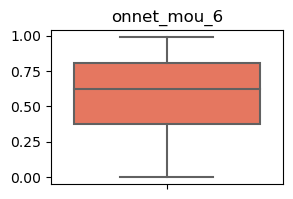

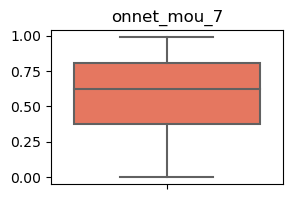

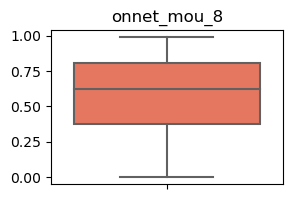

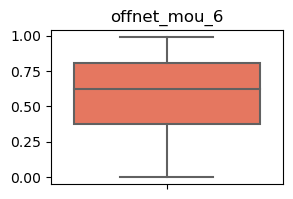

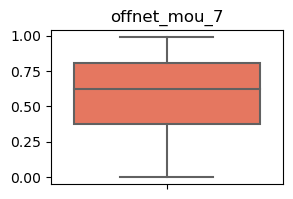

...

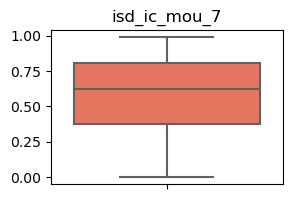

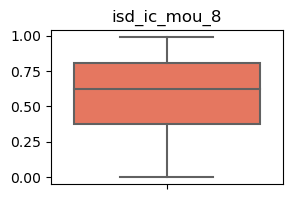

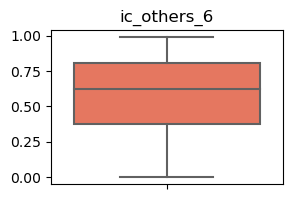

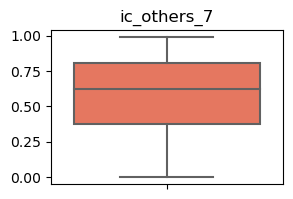

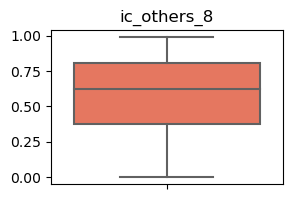

In [38]:
# Univariate Numerical Analysis:
for i in int_float_list1:
    plt.figure(figsize = (3,2))
    a = sns.boxplot(telData[i].describe(),palette = 'Reds',y=[0.0,0.50,0.75,0.99]).set(title= telData[i].name)
                                                                                            
plt.show()

#### INSIGHTS:

All the valriables lies in between 40% to 80%.They all have steady increase and decrease in values.They don't have any Outliers as such.Data is well balanced.  

#### 3.1.8.2..... Bivariate Analysis of each Categorical Variable With Count Plot With Respect to Churn or not

In [39]:
telData['churn'].value_counts()

churn
0    27560
1     2441
Name: count, dtype: int64

In [40]:
objlist = []
for i in telData:
    if (telData[i].dtypes == 'object'):
        objlist.append(i)

In [41]:
objlist

['max_rech_data_6',
 'max_rech_data_7',
 'max_rech_data_8',
 'count_rech_2g_6',
 'count_rech_2g_7',
 'count_rech_2g_8',
 'count_rech_3g_6',
 'count_rech_3g_7',
 'count_rech_3g_8',
 'arpu_3g_6',
 'arpu_3g_7',
 'arpu_3g_8',
 'arpu_2g_6',
 'arpu_2g_7',
 'arpu_2g_8',
 'night_pck_user_6',
 'night_pck_user_7',
 'night_pck_user_8',
 'fb_user_6',
 'fb_user_7',
 'fb_user_8',
 'total_rech_data_amt_6',
 'total_rech_data_amt_7',
 'total_rech_data_amt_8']

In [42]:
numlist=['night_pck_user_6','night_pck_user_7', 'night_pck_user_8', 'fb_user_6', 'fb_user_7', 'fb_user_8']
for i in numlist:
    telData[i] = telData[i].astype(int)

## 3.2 Comparative Study on Month 6,7,8

In [43]:
#list of month 6,7,8 for Analysis
month_6_list = ['max_rech_data_6','count_rech_2g_6','count_rech_3g_6','fb_user_6','night_pck_user_6']
month_7_list = ['max_rech_data_7','count_rech_2g_7','count_rech_3g_7','fb_user_7','night_pck_user_7']
month_8_list = ['max_rech_data_8','count_rech_2g_8','count_rech_3g_8','fb_user_8','night_pck_user_8']

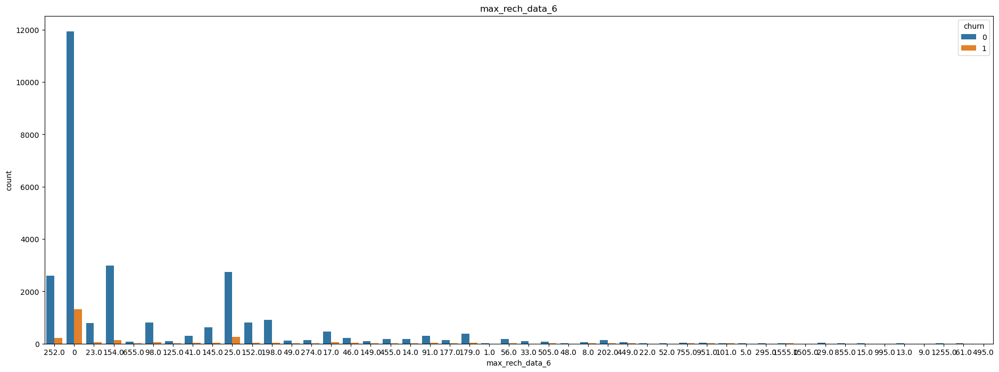

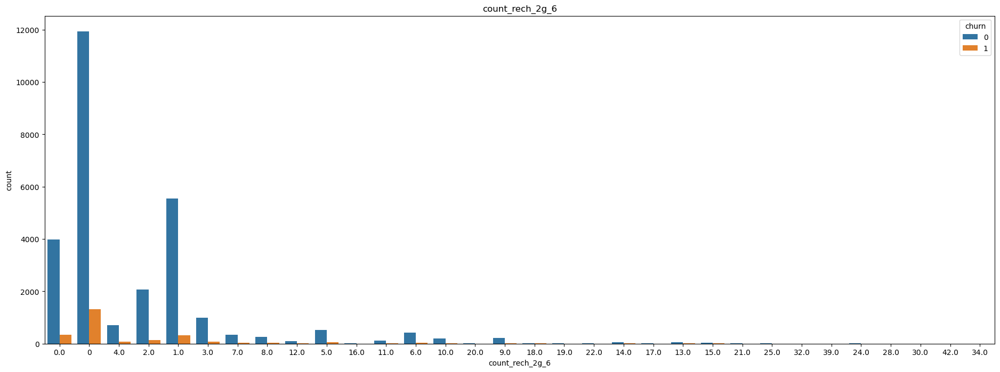

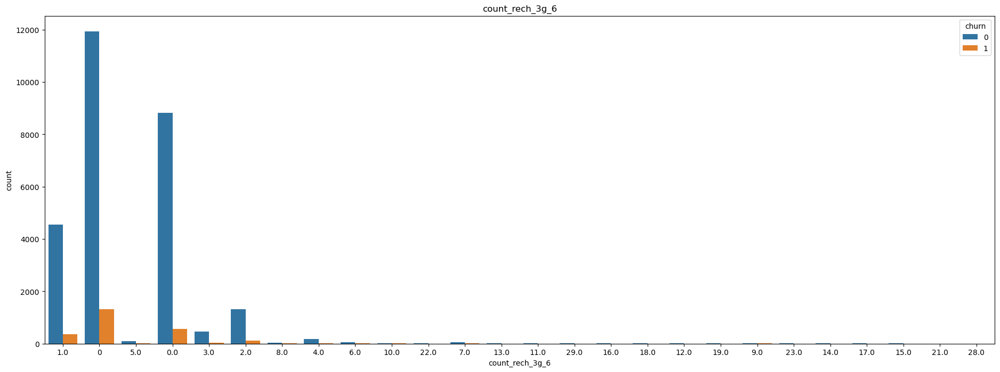

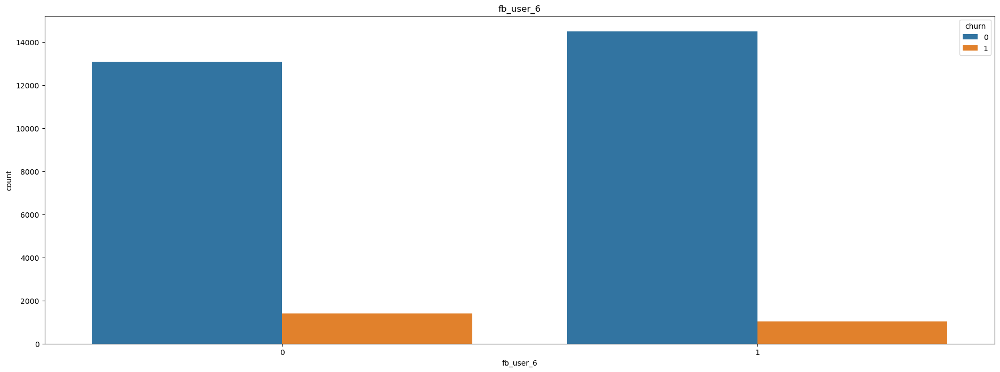

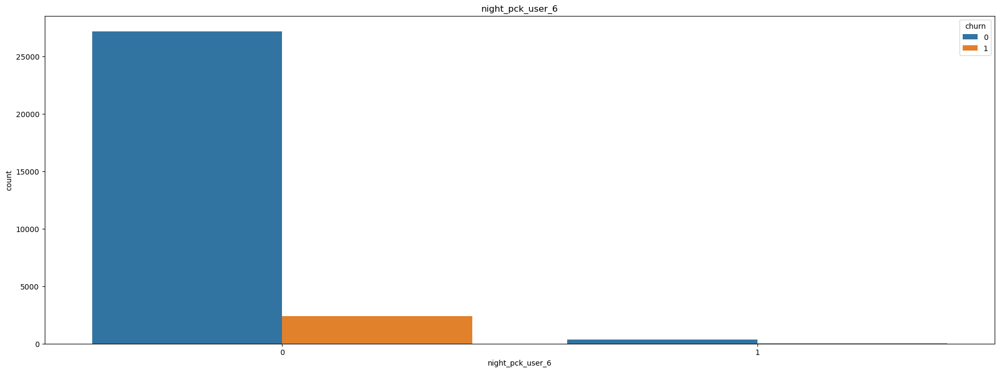

In [44]:
# Month -6 complete Bivaraite Analysis with respect to Churn 
for i in month_6_list:
    plt.figure(figsize = (23,8))
    sns.countplot(data=telData,x=telData[i], hue="churn").set_title(telData[i].name)    # displaying the title 
plt.show()

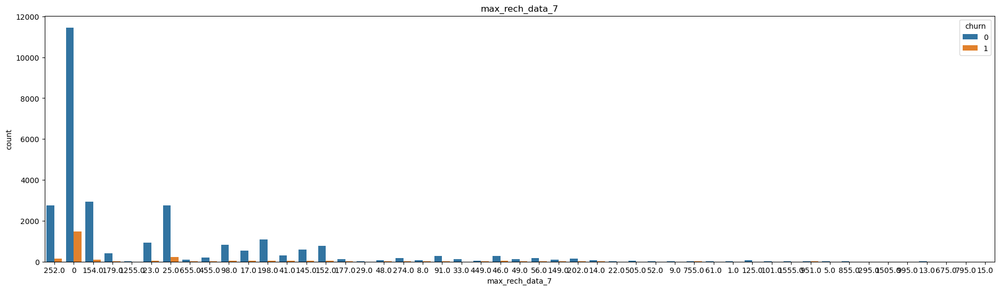

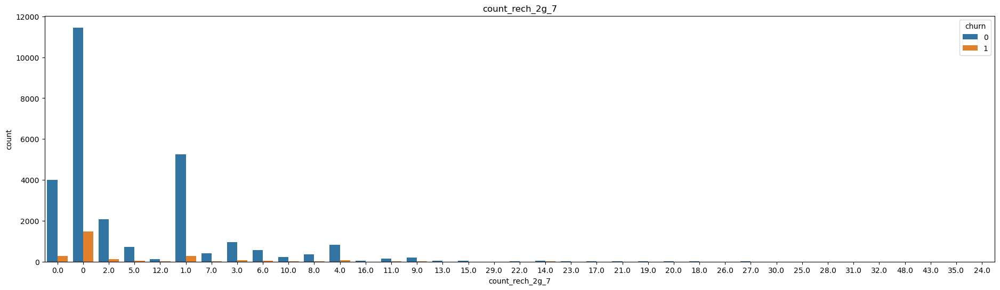

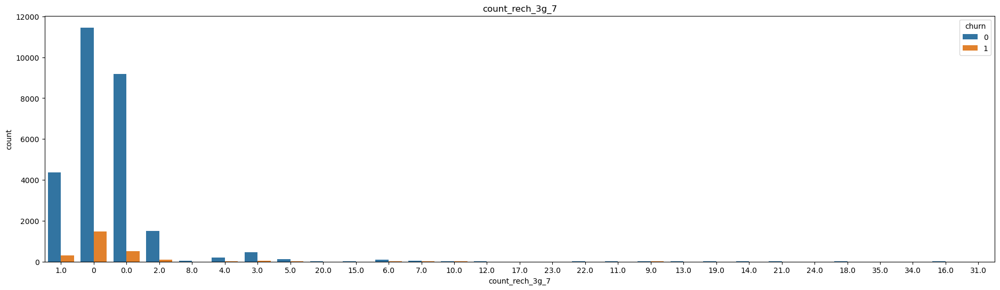

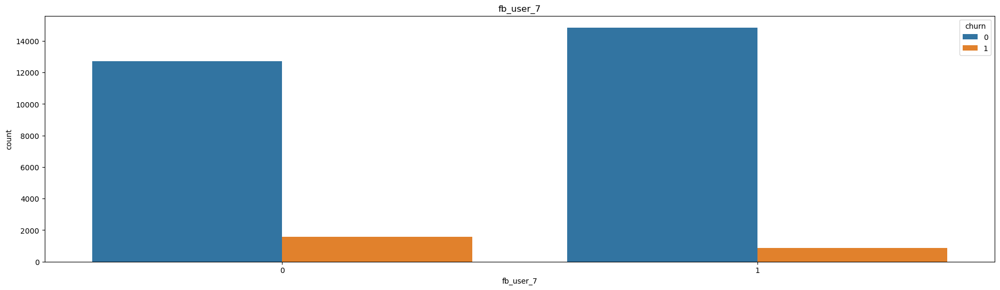

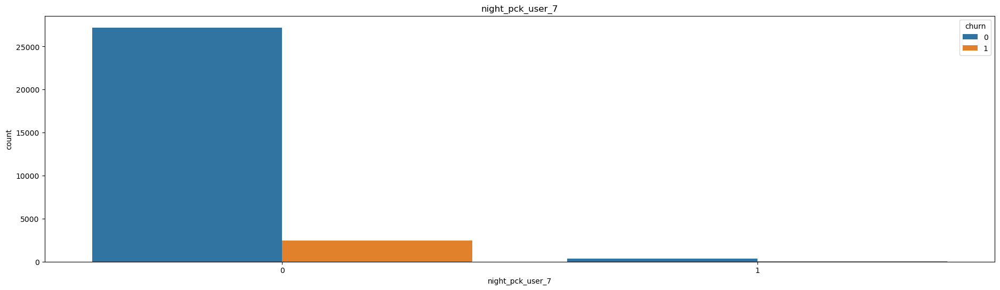

In [45]:
# Month -7 complete Bivaraite Analysis with respect to Churn 
for i in month_7_list:
    plt.figure(figsize = (23,6))
    sns.countplot(data=telData,x=telData[i], hue="churn").set_title(telData[i].name) # displaying the title 
    plt.show()

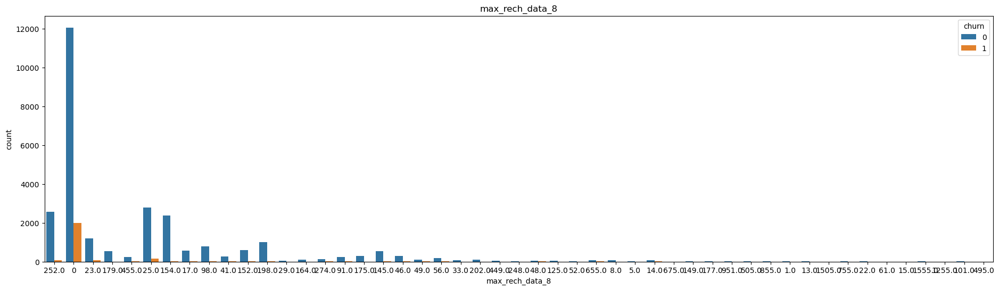

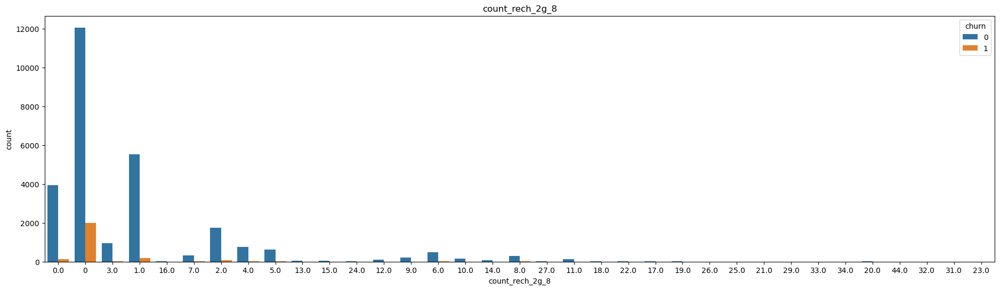

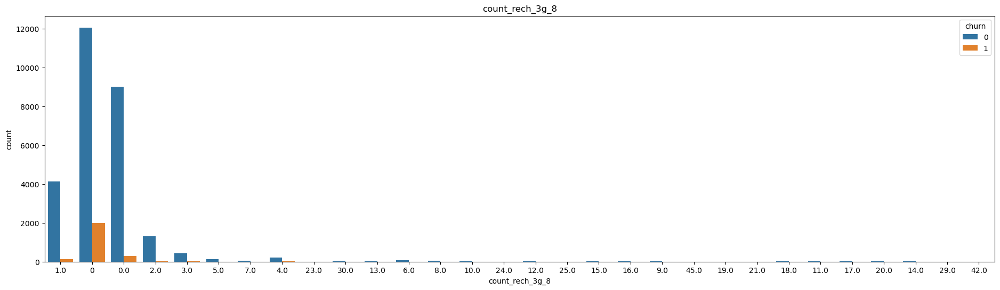

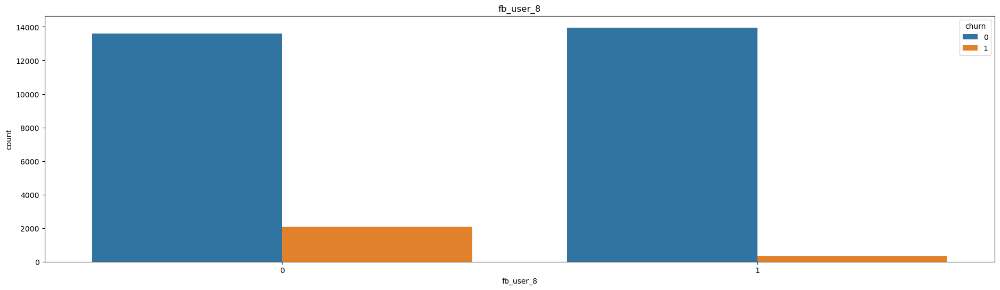

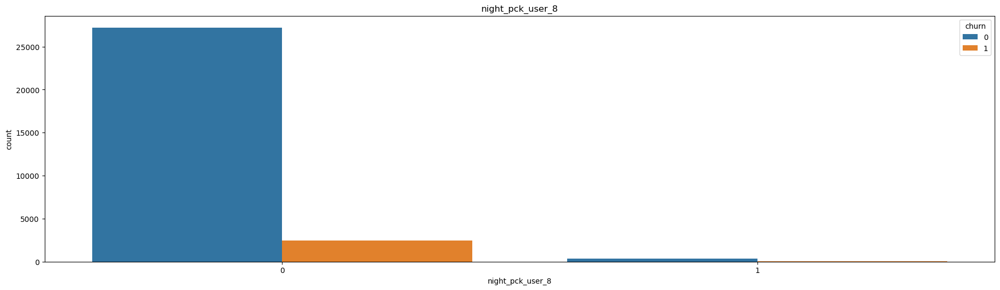

In [46]:
# Month -8 complete Bivaraite Analysis with respect to Churn 
for i in month_8_list:
    plt.figure(figsize = (23,6))
    sns.countplot(data=telData,x=telData[i], hue="churn").set_title(telData[i].name) # displaying the title 
    plt.show()

INSIGHTS:
    We analyse all Bivariate Variable of 6 ,7,8 month in details in below derived data.

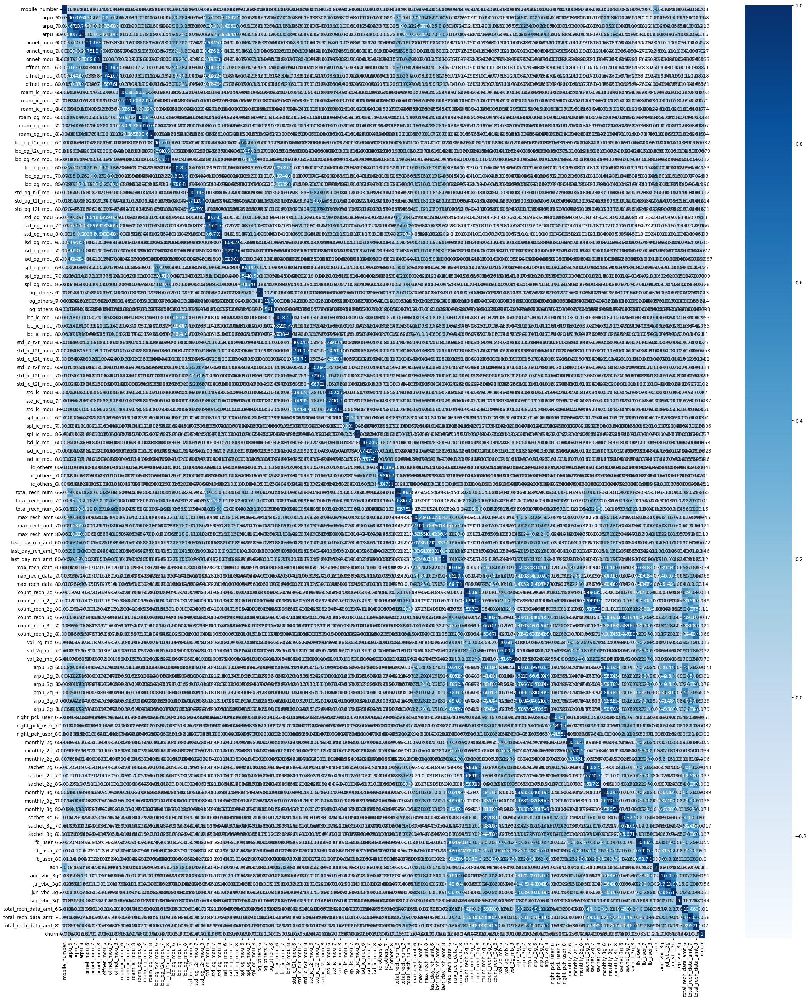

In [47]:
#Creating HEATMAP and checking corelation between each variable.
plt.figure(figsize=(30,35))
sns.heatmap(telData.corr(),cmap="Blues",annot=True)
plt.show()

#### INSIGHT:
  * There is lots of mullticolinearity exists we slowly drops all using Variance Inflamation Factor.and already we dropped some using corrs()

In [48]:
telData.shape

(30001, 112)

## 3.3 Derive some new feautres from the existing columns

In [49]:
# create a new colulmn, which would be average  of 6th & 7th months
# lets first create list of columns belonging to 6th and 7th months
col_list = telData.filter(regex='_6|_7').columns.str[:-2]
col_list.unique()

# print (telecom_hv_cust.shape)

# lets take the average now
for idx, col in enumerate(col_list.unique()):
    avg_col_name = "avg_"+col+"_av67" # lets create the column name dynamically
    col_6 = col+"_6"
    col_7 = col+"_7"
    telData[avg_col_name] = (telData[col_6].astype('int64')  + telData[col_7].astype('int64'))/ 2
telData[avg_col_name]

0         252.0
7           0.0
8         177.0
21          0.0
23        356.0
          ...  
99981     252.0
99984     319.0
99986      15.5
99988      77.0
99997    1232.5
Name: avg_total_rech_data_amt_av67, Length: 30001, dtype: float64

In [50]:
# we dont need columns from which we have derived new features, we will drop those columns
col_to_drop = telData.filter(regex='_6|_7').columns
telData.drop(col_to_drop, axis=1, inplace=True)
telData.shape

(30001, 77)

In [51]:
# lets now conevrt AON in months
telData['aon_mon'] = telData['aon']/30
telData.drop('aon', axis=1, inplace=True)
telData['aon_mon'].head()

0     32.266667
7     26.733333
8     10.500000
21    24.000000
23    20.133333
Name: aon_mon, dtype: float64

Text(0.5, 1.0, 'Tenure Graph')

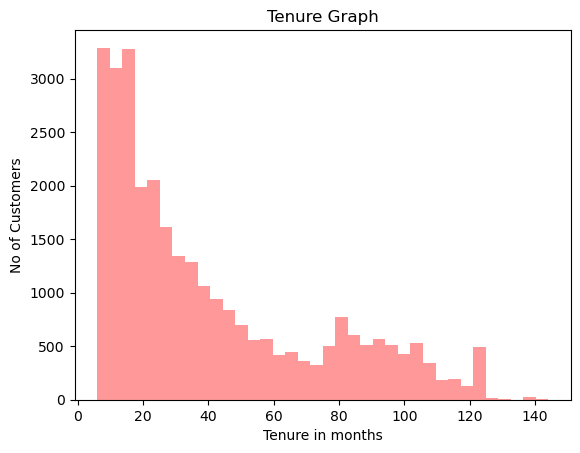

In [52]:
ax = sns.distplot(telData['aon_mon'], hist=True, kde=False, 
             bins=int(180/5), color = 'red', 
             )
ax.set_ylabel('No of Customers')
ax.set_xlabel('Tenure in months')
ax.set_title('Tenure Graph')
# below graph simply shows the tenure of the customers

#### INSIGHTS:
    * Around 3500 users uses a particular network for atleast 20 months ,then gradually the its starts decreasing ,Well only 500 users uses a network for about 120 months i,e 5 years approx.

<Axes: >

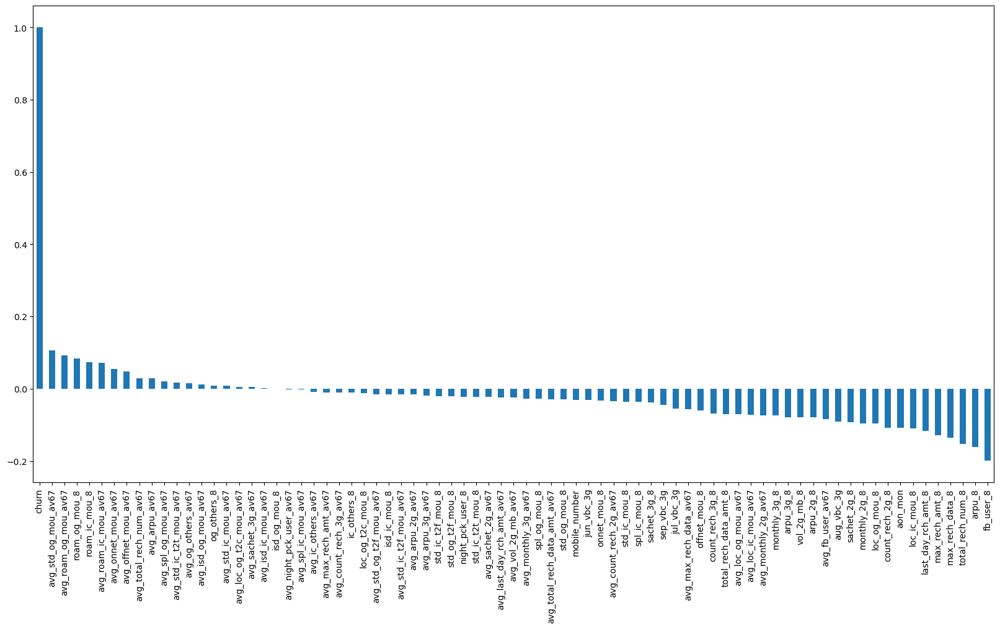

In [53]:
# lets check correlation of churn with other columns
plt.figure(figsize=(20,10))
telData.corr()['churn'].sort_values(ascending = False).plot(kind='bar')

#### INSIGHTS: 
* 1. Avg Outgoing Calls & calls on romaning for 6 & 7th months are positively correlated with churn. 
* 2. Avg Revenue, No. Of Recharge for 8th month and fb_user of 8 month has negative correlation with churn.
    

In [54]:
tenure_range = [0, 6, 12, 24, 60, 61]
tenure_label = [ '0-6 Months', '6-12 Months', '1-2 Yrs', '2-5 Yrs', '5 Yrs and above']
telData['tenure_range'] = pd.cut(telData['aon_mon'], tenure_range, labels=tenure_label)
telData['tenure_range'].head()

0         2-5 Yrs
7         2-5 Yrs
8     6-12 Months
21        1-2 Yrs
23        1-2 Yrs
Name: tenure_range, dtype: category
Categories (5, object): ['0-6 Months' < '6-12 Months' < '1-2 Yrs' < '2-5 Yrs' < '5 Yrs and above']

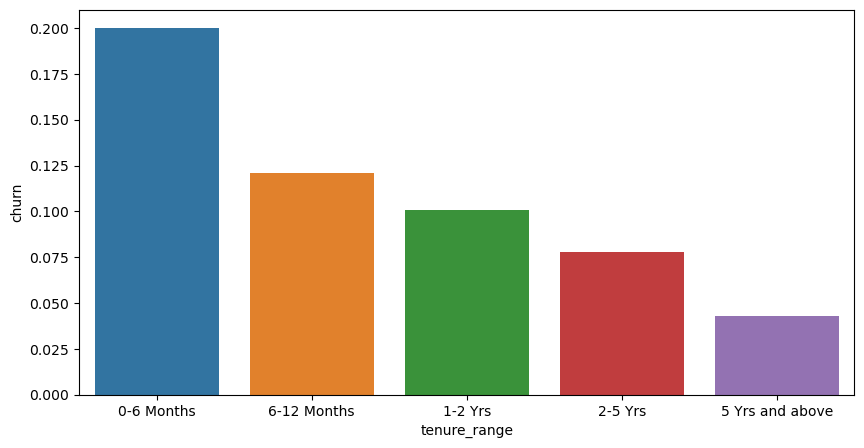

In [55]:
plt.figure(figsize=[10, 5])
sns.barplot(x='tenure_range', y='churn', data=telData,ci = None)
plt.show()

#### Max Users likes to churn in between 0-6 months were as very less user continue with the services 5 Years and above.On an average users probability of churning in between 6months to 5 years are almost same

<Axes: xlabel='total_rech_num_8', ylabel='arpu_8'>

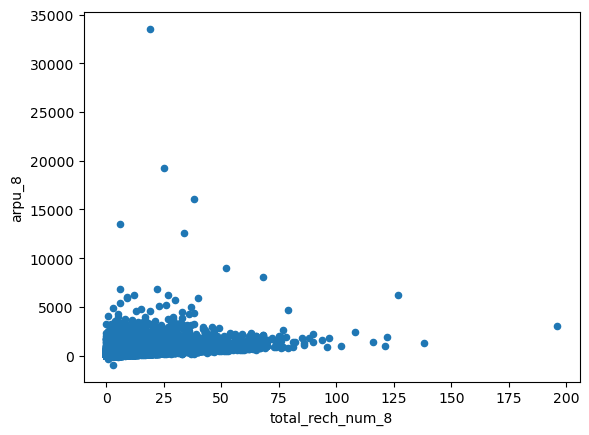

In [56]:
# lets now draw a scatter plot between total recharge and avg revenue for the 8th month
telData[['total_rech_num_8', 'arpu_8']].plot.scatter(x = 'total_rech_num_8',y='arpu_8')

<Axes: xlabel='aon_mon', ylabel='avg_arpu_av67'>

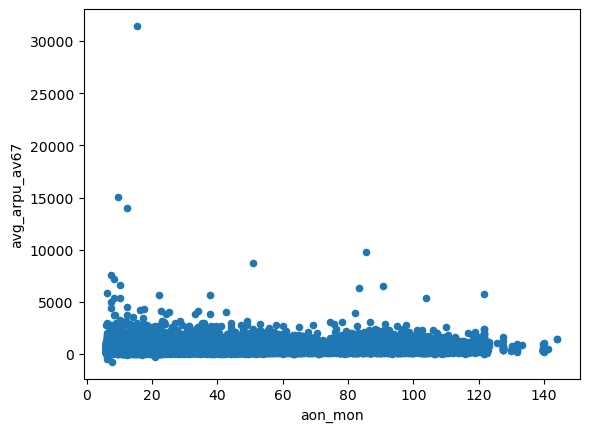

In [57]:
# plot between tenure and revenue
telData[['aon_mon', 'avg_arpu_av67']].plot.scatter(x = 'aon_mon',y='avg_arpu_av67')

#### INSIGHTS:
 plots between Tenure and revenue is scatted evenly.

## 3.4 Churn Vs Other Important Features Plots

<Axes: xlabel='churn', ylabel='aon_mon'>

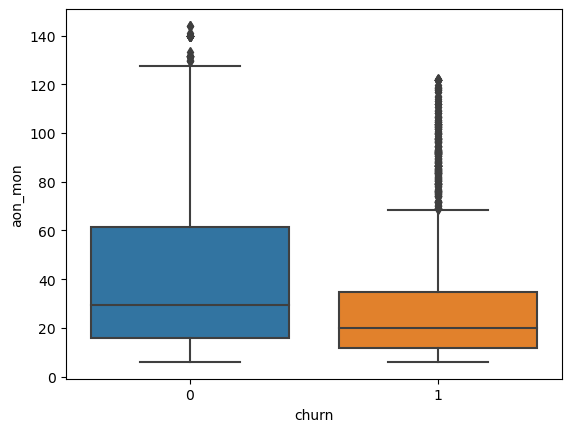

In [58]:
sns.boxplot(x = telData.churn, y = telData.aon_mon)

# from the below plot , its clear tenured customers do no churn and they keep availing telecom services

##### INSIGHTS:
   Churning ratio is high as compared to not churn 10 - 30% people not churned.

Text(0.5, 1.0, 'Churn Vs Base Cost')

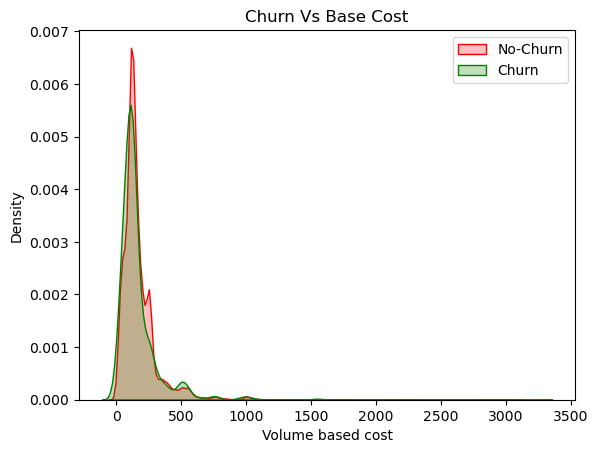

In [59]:
# churn Vs Base Cost
ax = sns.kdeplot(telData.avg_max_rech_amt_av67[(telData["churn"] == 0)],
                color="Red", shade = True)
ax = sns.kdeplot(telData.avg_max_rech_amt_av67[(telData["churn"] == 1)],
                ax =ax, color="Green", shade= True)
ax.legend(["No-Churn","Churn"],loc='upper right')
ax.set_ylabel('Density')
ax.set_xlabel('Volume based cost')
ax.set_title('Churn Vs Base Cost')

#### INSIGHTS:
    Average Max recharge amount for 6 & 7 month are Churned more than not churn.

Text(0.5, 1.0, 'Distribution of Max Recharge Amount by churn')

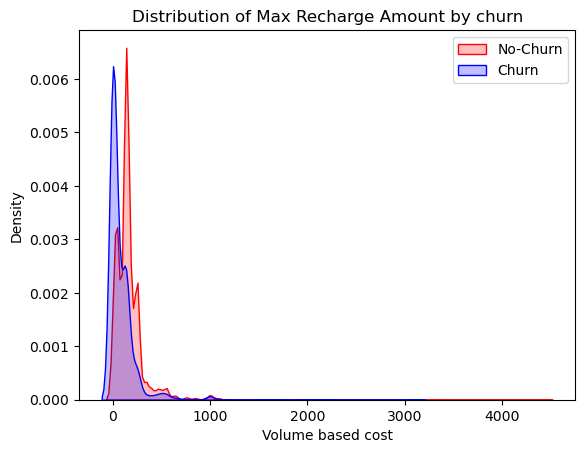

In [60]:
# churn vs max rechare amount
ax = sns.kdeplot(telData.max_rech_amt_8[(telData["churn"] == 0)],
                color="Red", shade = True)
ax = sns.kdeplot(telData.max_rech_amt_8[(telData["churn"] == 1)],
                ax =ax, color="Blue", shade= True)
ax.legend(["No-Churn","Churn"],loc='upper right')
ax.set_ylabel('Density')
ax.set_xlabel('Volume based cost')
ax.set_title('Distribution of Max Recharge Amount by churn')

#### INSIGHTS:
    Distribution of Max Recharge Amount by churn for 8 month are Churned more than not churn.

In [61]:
# we are going to drop some feature which are not necessary for our Analysis and also
# lets drop tenure range because it is highly correlated with AON MONTH column
telData.drop(['mobile_number','tenure_range'], axis=1, inplace=True)


In [62]:
telData.shape

(30001, 76)

In [63]:
telData = telData.dropna()

In [64]:
telData.reset_index(drop = True)

,arpu_8,onnet_mou_8,offnet_mou_8,roam_ic_mou_8,roam_og_mou_8,loc_og_t2c_mou_8,loc_og_mou_8,std_og_t2f_mou_8,std_og_mou_8,isd_og_mou_8,...,avg_arpu_3g_av67,avg_arpu_2g_av67,avg_night_pck_user_av67,avg_monthly_2g_av67,avg_sachet_2g_av67,avg_monthly_3g_av67,avg_sachet_3g_av67,avg_fb_user_av67,avg_total_rech_data_amt_av67,aon_mon
0,213.803,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,212.0,212.0,0.0,0.0,0.0,1.0,0.0,1.0,252.0,32.266667
1,3171.480,52.29,325.91,31.64,38.06,0.00,255.79,16.68,77.84,10.01,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,26.733333
2,137.362,35.08,136.48,0.00,0.00,7.15,63.04,0.00,98.28,0.00,...,0.0,0.0,0.0,0.5,0.5,0.0,0.0,0.5,177.0,10.500000
3,637.760,85.14,983.39,0.00,0.00,0.00,129.74,0.00,938.79,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,24.000000
4,366.966,33.58,205.89,0.00,0.00,17.71,182.14,0.00,39.61,0.00,...,153.0,150.5,0.0,0.0,0.0,1.0,0.0,0.5,356.0,20.133333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29996,393.474,103.24,61.44,0.00,0.00,0.00,150.59,0.00,14.01,0.00,...,212.0,212.0,0.0,0.0,0.0,1.0,0.0,1.0,252.0,15.766667
29997,118.707,5.71,18.26,0.00,0.00,7.28,16.69,0.00,0.00,0.00,...,0.0,4.0,0.0,0.5,2.0,0.0,0.0,1.0,319.0,27.333333
29998,564.334,775.41,595.44,0.00,0.00,9.15,1225.06,0.00,145.79,0.00,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,15.5,89.866667
29999,402.080,2.46,248.33,0.00,0.00,0.01,130.48,0.00,120.29,0.00,...,0.0,0.0,0.0,0.5,0.0,0.0,0.0,0.5,77.0,10.933333


#### Our data is perfectly prepared for Model Building

## Step 4 : Test-Train Split

In [65]:
# Putting feature variable to X
X = telData.drop(['churn'], axis=1)
X.head()

,arpu_8,onnet_mou_8,offnet_mou_8,roam_ic_mou_8,roam_og_mou_8,loc_og_t2c_mou_8,loc_og_mou_8,std_og_t2f_mou_8,std_og_mou_8,isd_og_mou_8,...,avg_arpu_3g_av67,avg_arpu_2g_av67,avg_night_pck_user_av67,avg_monthly_2g_av67,avg_sachet_2g_av67,avg_monthly_3g_av67,avg_sachet_3g_av67,avg_fb_user_av67,avg_total_rech_data_amt_av67,aon_mon
0,213.803,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,212.0,212.0,0.0,0.0,0.0,1.0,0.0,1.0,252.0,32.266667
7,3171.480,52.29,325.91,31.64,38.06,0.00,255.79,16.68,77.84,10.01,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,26.733333
8,137.362,35.08,136.48,0.00,0.00,7.15,63.04,0.00,98.28,0.00,...,0.0,0.0,0.0,0.5,0.5,0.0,0.0,0.5,177.0,10.500000
21,637.760,85.14,983.39,0.00,0.00,0.00,129.74,0.00,938.79,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,24.000000
23,366.966,33.58,205.89,0.00,0.00,17.71,182.14,0.00,39.61,0.00,...,153.0,150.5,0.0,0.0,0.0,1.0,0.0,0.5,356.0,20.133333


In [66]:
# Putting response variable to y
y = telData['churn']
y.head()

0     1
7     1
8     0
21    0
23    0
Name: churn, dtype: int32

In [67]:
# Splitting the data into train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, test_size=0.3, random_state=100)

## Step 5 : Feature Scaling

In [68]:
# apply scaling on the dataset
from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [69]:
# As discussed earlier, given dataset is skewed, lets balance the dataset
from imblearn.over_sampling import SMOTE
smt = SMOTE(random_state = 45 )
X_sampled_us , y_sampled_us = smt.fit_resample(X_train,y_train)
len(X_sampled_us)

38618

In [70]:
print(sorted(Counter(y_sampled_us).items()))

[(0, 19309), (1, 19309)]


In [71]:
print(X_sampled_us.shape)
print(y_sampled_us.shape)

print("Imbalance in Training dataset:",(y_sampled_us != 0).sum()/(y_sampled_us == 0).sum())

(38618, 75)
(38618,)
Imbalance in Training dataset: 1.0


## Step 6 Simple Logistic Regression 

In [72]:
# Logistic regression model
logm1 = sm.GLM(y_train,(sm.add_constant(X_train)), family = sm.families.Binomial())
logm1.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                  churn   No. Observations:                21000
Model:                            GLM   Df Residuals:                    20928
Model Family:                Binomial   Df Model:                           71
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -4019.2
Date:                Mon, 06 Nov 2023   Deviance:                       8038.3
Time:                        13:42:10   Pearson chi2:                 1.66e+12
No. Iterations:                    10   Pseudo R-squ. (CS):             0.1625
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -1.2550      0.178     -7.064      0.000      -1.603      -0.907
x1          -145.8281      8.319    -17.529      0.000    -162.133    -129.523
x2          -252.6465     53.004     -4.767      0.000    -356.533    -148.760
x3          -328.5879     68.971     -4.764      0.000    -463.768    -193.407
x4             2.7250      1.153      2.363      0.018       0.465       4.985
x5           148.6691     26.413      5.629      0.000      96.900     200.438
x6             5.9912      2.194      2.731      0.006       1.691      10.292
x7           271.2133     54.477      4.978      0.000     164.440     377.987
x8            -1.7974      3.332     -0.539      0.590      -8.329       4.734
x9           343.3222     68.962      4.978      0.000     208.159     478.485
x10          196.1822     29.271      6.702      0.000     138.812     253.553
x11           10.1133      3.050      3.316      0.001       4.136      16.091
x12            5.8490      2.326      2.514      0.012       1.289      10.409
x13           -7.3703      1.475     -4.997      0.000     -10.261      -4.479
x14           -7.1209      5.427     -1.312      0.189     -17.757       3.515
x15           -7.3277      6.495     -1.128      0.259     -20.057       5.402
x16           -3.7579      3.558     -1.056      0.291     -10.731       3.215
x17          -11.4322      2.658     -4.301      0.000     -16.641      -6.223
x18            0.1669      1.919      0.087      0.931      -3.594       3.927
x19            6.6307      5.602      1.184      0.237      -4.349      17.610
x20          -15.0090      1.768     -8.487      0.000     -18.475     -11.543
x21           -0.3685      1.450     -0.254      0.799      -3.210       2.473
x22          -15.2046      1.901     -7.999      0.000     -18.930     -11.479
x23           -1.5524      1.668     -0.931      0.352      -4.821       1.716
x24           -3.6059      1.018     -3.541      0.000      -5.602      -1.610
x25           -2.5569      1.995     -1.282      0.200      -6.466       1.352
x26          -14.7237      3.684     -3.997      0.000     -21.944      -7.503
x27            7.2935      6.098      1.196      0.232      -4.659      19.246
x28            1.5557      5.966      0.261      0.794     -10.138      13.249
x29           -0.1142      0.516     -0.221      0.825      -1.126       0.897
x30           -0.4244      1.141     -0.372      0.710      -2.660       1.811
x31           -3.5577      0.985     -3.610      0.000      -5.489      -1.626
x32           -0.7041      2.776     -0.254      0.800      -6.146       4.738
x33           -2.7314      2.055     -1.329      0.184      -6.758       1.296
x34           -0.5916      0.155     -3.813      0.000      -0.896      -0.288
x35           -7.1086      2.634     -2.699      0.007     -12.271      -1.946
x3

## Step 7: Feature Selection Using RFE With Logistic Regression

In [73]:
logreg = LogisticRegression()
from sklearn.feature_selection import RFE
rfe = RFE(logreg, step =15)             # running RFE with 15 variables as output
rfe = rfe.fit(X_train, y_train)

In [74]:
rfe.support_

array([ True,  True,  True,  True,  True, False,  True, False,  True,
       False, False, False,  True, False, False,  True,  True, False,
       False,  True,  True,  True, False,  True, False,  True, False,
       False, False,  True,  True, False, False,  True,  True, False,
        True,  True, False,  True, False,  True,  True,  True, False,
        True, False,  True, False, False, False, False, False, False,
       False, False, False, False,  True,  True, False, False, False,
        True,  True,  True,  True, False,  True,  True, False,  True,
       False, False,  True])

In [75]:
X_train = pd.DataFrame(X_train, columns = X.columns)
X_test = pd.DataFrame(X_test, columns=X.columns)


In [76]:
list(zip(X_train.columns, rfe.support_, rfe.ranking_))

[('arpu_8', True, 1),
 ('onnet_mou_8', True, 1),
 ('offnet_mou_8', True, 1),
 ('roam_ic_mou_8', True, 1),
 ('roam_og_mou_8', True, 1),
 ('loc_og_t2c_mou_8', False, 4),
 ('loc_og_mou_8', True, 1),
 ('std_og_t2f_mou_8', False, 3),
 ('std_og_mou_8', True, 1),
 ('isd_og_mou_8', False, 4),
 ('spl_og_mou_8', False, 3),
 ('og_others_8', False, 2),
 ('loc_ic_mou_8', True, 1),
 ('std_ic_t2t_mou_8', False, 2),
 ('std_ic_t2f_mou_8', False, 3),
 ('std_ic_mou_8', True, 1),
 ('spl_ic_mou_8', True, 1),
 ('isd_ic_mou_8', False, 4),
 ('ic_others_8', False, 4),
 ('total_rech_num_8', True, 1),
 ('max_rech_amt_8', True, 1),
 ('last_day_rch_amt_8', True, 1),
 ('max_rech_data_8', False, 3),
 ('count_rech_2g_8', True, 1),
 ('count_rech_3g_8', False, 3),
 ('vol_2g_mb_8', True, 1),
 ('arpu_3g_8', False, 4),
 ('arpu_2g_8', False, 4),
 ('night_pck_user_8', False, 4),
 ('monthly_2g_8', True, 1),
 ('sachet_2g_8', True, 1),
 ('monthly_3g_8', False, 3),
 ('sachet_3g_8', False, 3),
 ('fb_user_8', True, 1),
 ('aug_vbc

In [77]:
col = X_train.columns[rfe.support_]

In [78]:
X_train.columns[~rfe.support_]

Index(['loc_og_t2c_mou_8', 'std_og_t2f_mou_8', 'isd_og_mou_8', 'spl_og_mou_8',
       'og_others_8', 'std_ic_t2t_mou_8', 'std_ic_t2f_mou_8', 'isd_ic_mou_8',
       'ic_others_8', 'max_rech_data_8', 'count_rech_3g_8', 'arpu_3g_8',
       'arpu_2g_8', 'night_pck_user_8', 'monthly_3g_8', 'sachet_3g_8',
       'jul_vbc_3g', 'total_rech_data_amt_8', 'avg_onnet_mou_av67',
       'avg_loc_og_t2c_mou_av67', 'avg_std_og_t2f_mou_av67',
       'avg_isd_og_mou_av67', 'avg_spl_og_mou_av67', 'avg_og_others_av67',
       'avg_loc_ic_mou_av67', 'avg_std_ic_t2t_mou_av67',
       'avg_std_ic_t2f_mou_av67', 'avg_std_ic_mou_av67', 'avg_spl_ic_mou_av67',
       'avg_isd_ic_mou_av67', 'avg_ic_others_av67',
       'avg_last_day_rch_amt_av67', 'avg_max_rech_data_av67',
       'avg_count_rech_2g_av67', 'avg_night_pck_user_av67',
       'avg_monthly_3g_av67', 'avg_fb_user_av67',
       'avg_total_rech_data_amt_av67'],
      dtype='object')

#### Assessing the model with StatsModels

In [79]:
#### Model1
X_train_sm = sm.add_constant(X_train[col])
logm1 = sm.GLM(y_train.values.reshape(-1,1),X_train_sm, family = sm.families.Binomial())
res = logm1.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                      y   No. Observations:                21000
Model:                            GLM   Df Residuals:                    20963
Model Family:                Binomial   Df Model:                           36
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -4066.5
Date:                Mon, 06 Nov 2023   Deviance:                       8133.1
Time:                        13:42:12   Pearson chi2:                 6.71e+11
No. Iterations:                    10   Pseudo R-squ. (CS):             0.1587
Covariance Type:            nonrobust                                         
===========================================================================================
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                      -1.2500      0.160     -7.797      0.000      -1.564      -0.936
arpu_8                   -135.6348      8.224    -16.493      0.000    -151.753    -119.516
onnet_mou_8                28.6812     17.496      1.639      0.101      -5.611      62.973
offnet_mou_8               37.5673     22.797      1.648      0.099      -7.114      82.249
roam_ic_mou_8               2.9069      1.157      2.512      0.012       0.639       5.174
roam_og_mou_8               8.4108      8.793      0.956      0.339      -8.824      25.646
loc_og_mou_8              -18.8886     18.060     -1.046      0.296     -54.286      16.509
std_og_mou_8              -23.9515     22.816     -1.050      0.294     -68.670      20.767
loc_ic_mou_8               -5.8885      1.226     -4.803      0.000      -8.291      -3.486
std_ic_mou_8               -3.6350      2.280     -1.594      0.111      -8.103       0.833
spl_ic_mou_8              -11.5479      2.635     -4.383      0.000     -16.712      -6.384
total_rech_num_8          -15.4837      1.746     -8.868      0.000     -18.906     -12.062
max_rech_amt_8             -0.1307      1.433     -0.091      0.927      -2.939       2.678
last_day_rch_amt_8        -15.6543      1.887     -8.297      0.000     -19.352     -11.957
count_rech_2g_8            -3.6932      0.794     -4.654      0.000      -5.249      -2.138
vol_2g_mb_8               -14.9497      3.658     -4.087      0.000     -22.119      -7.780
monthly_2g_8               -1.4663      0.957     -1.531      0.126      -3.343       0.410
sachet_2g_8                -3.5266      0.784     -4.500      0.000      -5.063      -1.991
fb_user_8                  -0.5426      0.110     -4.931      0.000      -0.758      -0.327
aug_vbc_3g                 -5.5877      2.404     -2.325      0.020     -10.299      -0.877
jun_vbc_3g                  0.6904      1.253      0.551      0.582      -1.765       3.146
sep_vbc_3g                -49.3462     14.144     -3.489      0.000     -77.068     -21.624
avg_arpu_av67              67.5926      6.056     11.162      0.000      55.724      79.462
avg_offnet_mou_av67         0.7285      0.913      0.798      0.425      -1.062       2.519
avg_roam_ic_mou_av67        3.1652      1.557      2.033      0.042       0.113       6.217
avg_roam_og_mou_av67       -1.3287      0.940     -1.413      0.158      -3.171       0.514
avg_loc_og_mou_av67        -6.2322      1.173     -5.314      0.000      -8.531      -3.934
avg_std_og_mou_av67        -2.4594      0.895     -2.749      0.006      -4.213      -0.706
avg_total_rech_num_av67     2.1154      0.646      3.274      0.001       0.849       3.382
avg_max_rech_amt_av67       3.0209      0.895      3.376      0.001       1.267       4.775
avg_count_rech_3g_av67     -2.2028      3.533  

In [80]:
# Getting the predicted values on the train set
y_train_pred = res.predict(X_train_sm)
y_train_pred = y_train_pred.values.reshape(-1)
y_train_pred[:10]


array([0.05726043, 0.01267206, 0.0453831 , 0.01132505, 0.02389487,
       0.00206341, 0.03911872, 0.01516154, 0.02566   , 0.07983403])

##### Creating a dataframe with the actual churn flag and the predicted probabilities

In [81]:
y_train_pred_final = pd.DataFrame({'Churn':y_train.values, 'Churn_Prob':y_train_pred})
y_train_pred_final['Circle_ID'] = y_train.index
y_train_pred_final.head()

,Churn,Churn_Prob,Circle_ID
0,0,0.057260,39186
1,0,0.012672,39833
2,0,0.045383,38778
3,0,0.011325,43026
4,0,0.023895,12271


##### Creating new column 'predicted' with 1 if Churn_Prob > 0.5 else 0

In [82]:
y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)
# Let's see the head
y_train_pred_final.head()

,Churn,Churn_Prob,Circle_ID,predicted
0,0,0.057260,39186,0
1,0,0.012672,39833,0
2,0,0.045383,38778,0
3,0,0.011325,43026,0
4,0,0.023895,12271,0


In [83]:
# Confusion matrix 
confusion = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final.predicted )
print(confusion)

[[19125   184]
 [ 1297   394]]


In [84]:
# Let's check the overall accuracy.
print(metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.predicted))

0.9294761904761905


#### Checking VIFs

In [85]:
# Check for the VIF values of the feature variables. 
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [86]:
# Create a dataframe that will contain the names of all the feature variables and their respective VIFs
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
13,count_rech_2g_8,inf
16,sachet_2g_8,inf
15,monthly_2g_8,inf
6,std_og_mou_8,237.53
2,offnet_mou_8,184.04
1,onnet_mou_8,136.13
5,loc_og_mou_8,100.15
21,avg_arpu_av67,28.85
29,avg_count_rech_3g_av67,19.66
0,arpu_8,18.45


* There are a few variables with high VIF. It's best to drop these variables as they aren't helping much with prediction and unnecessarily making the model complex. Here the variable  <b> count_rech_2g_8, sachet_2g_8 ,monthly_2g_8 </b> are giving result <b>inf</b> .It means they are highly collinear and there variance is equal to 1 which is infinity .Hence we drop one automatically model doen't fallow mullicolinearity.Hence we are dropping <b> count_rech_2g_8 </b> .After that we can observe that are VIF become stable,none reaches to infinity.

In [87]:
col = col.drop('count_rech_2g_8', 1)

In [88]:
#### MODEL 2
# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm2 = sm.GLM(y_train.values.reshape(-1,1),X_train_sm, family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                      y   No. Observations:                21000
Model:                            GLM   Df Residuals:                    20963
Model Family:                Binomial   Df Model:                           36
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -4066.5
Date:                Mon, 06 Nov 2023   Deviance:                       8133.1
Time:                        13:42:13   Pearson chi2:                 6.71e+11
No. Iterations:                    10   Pseudo R-squ. (CS):             0.1587
Covariance Type:            nonrobust                                         
===========================================================================================
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                      -1.2500      0.160     -7.797      0.000      -1.564      -0.936
arpu_8                   -135.6348      8.224    -16.493      0.000    -151.753    -119.516
onnet_mou_8                28.6812     17.496      1.639      0.101      -5.611      62.973
offnet_mou_8               37.5673     22.797      1.648      0.099      -7.114      82.249
roam_ic_mou_8               2.9069      1.157      2.512      0.012       0.639       5.174
roam_og_mou_8               8.4108      8.793      0.956      0.339      -8.824      25.646
loc_og_mou_8              -18.8886     18.060     -1.046      0.296     -54.286      16.509
std_og_mou_8              -23.9515     22.816     -1.050      0.294     -68.670      20.767
loc_ic_mou_8               -5.8885      1.226     -4.803      0.000      -8.291      -3.486
std_ic_mou_8               -3.6350      2.280     -1.594      0.111      -8.103       0.833
spl_ic_mou_8              -11.5479      2.635     -4.383      0.000     -16.712      -6.384
total_rech_num_8          -15.4837      1.746     -8.868      0.000     -18.906     -12.062
max_rech_amt_8             -0.1307      1.433     -0.091      0.927      -2.939       2.678
last_day_rch_amt_8        -15.6543      1.887     -8.297      0.000     -19.352     -11.957
vol_2g_mb_8               -14.9497      3.658     -4.087      0.000     -22.119      -7.780
monthly_2g_8               -1.8860      0.976     -1.933      0.053      -3.799       0.027
sachet_2g_8                -7.2197      1.574     -4.588      0.000     -10.304      -4.136
fb_user_8                  -0.5426      0.110     -4.931      0.000      -0.758      -0.327
aug_vbc_3g                 -5.5877      2.404     -2.325      0.020     -10.299      -0.877
jun_vbc_3g                  0.6904      1.253      0.551      0.582      -1.765       3.146
sep_vbc_3g                -49.3462     14.144     -3.489      0.000     -77.068     -21.624
avg_arpu_av67              67.5926      6.056     11.162      0.000      55.724      79.462
avg_offnet_mou_av67         0.7285      0.913      0.798      0.425      -1.062       2.519
avg_roam_ic_mou_av67        3.1652      1.557      2.033      0.042       0.113       6.217
avg_roam_og_mou_av67       -1.3287      0.940     -1.413      0.158      -3.171       0.514
avg_loc_og_mou_av67        -6.2322      1.173     -5.314      0.000      -8.531      -3.934
avg_std_og_mou_av67        -2.4594      0.895     -2.749      0.006      -4.213      -0.706
avg_total_rech_num_av67     2.1154      0.646      3.274      0.001       0.849       3.382
avg_max_rech_amt_av67       3.0209      0.895      3.376      0.001       1.267       4.775
avg_count_rech_3g_av67     -2.2028      3.533     -0.624      0.533      -9.126       4.721
avg_vol_2g_mb_av67          2.9081      0.850  

In [89]:
# Getting the predicted values on the train set
y_train_pred = res.predict(X_train_sm)
y_train_pred = y_train_pred.values.reshape(-1)
y_train_pred[:10]

y_train_pred_final['Churn_Prob'] = y_train_pred
# Creating new column 'predicted' with 1 if Churn_Prob > 0.5 else 0
y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)
y_train_pred_final.head()

,Churn,Churn_Prob,Circle_ID,predicted
0,0,0.057260,39186,0
1,0,0.012672,39833,0
2,0,0.045383,38778,0
3,0,0.011325,43026,0
4,0,0.023895,12271,0


In [90]:
# Let's check the overall accuracy.
print(metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.predicted))

0.9294761904761905


* So overall the accuracy hasn't dropped much.

#### Checking VIF again

In [91]:
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
6,std_og_mou_8,237.53
2,offnet_mou_8,184.04
1,onnet_mou_8,136.13
5,loc_og_mou_8,100.15
20,avg_arpu_av67,28.85
28,avg_count_rech_3g_av67,19.66
0,arpu_8,18.45
31,avg_arpu_2g_av67,15.45
30,avg_arpu_3g_av67,15.22
34,avg_sachet_3g_av67,11.37


In [92]:
# Let's drop std_og_mou_8 since it has a high VIF
col = col.drop('std_og_mou_8')

In [93]:
#### MODEL 3
# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm3 = sm.GLM(y_train.values.reshape(-1,1),X_train_sm, family = sm.families.Binomial())
res = logm3.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                      y   No. Observations:                21000
Model:                            GLM   Df Residuals:                    20964
Model Family:                Binomial   Df Model:                           35
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -4067.1
Date:                Mon, 06 Nov 2023   Deviance:                       8134.2
Time:                        13:42:15   Pearson chi2:                 6.55e+11
No. Iterations:                    10   Pseudo R-squ. (CS):             0.1587
Covariance Type:            nonrobust                                         
===========================================================================================
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                      -1.2589      0.161     -7.806      0.000      -1.575      -0.943
arpu_8                   -135.8473      8.236    -16.495      0.000    -151.989    -119.706
onnet_mou_8                10.3728      1.410      7.355      0.000       7.609      13.137
offnet_mou_8               13.7288      1.976      6.949      0.000       9.857      17.601
roam_ic_mou_8               2.8903      1.156      2.499      0.012       0.624       5.157
roam_og_mou_8              17.5033      1.553     11.269      0.000      14.459      20.548
loc_og_mou_8               -0.0579      2.163     -0.027      0.979      -4.297       4.182
loc_ic_mou_8               -5.8484      1.224     -4.778      0.000      -8.248      -3.449
std_ic_mou_8               -3.6241      2.277     -1.592      0.111      -8.086       0.838
spl_ic_mou_8              -11.4995      2.633     -4.368      0.000     -16.660      -6.339
total_rech_num_8          -15.4335      1.746     -8.840      0.000     -18.855     -12.012
max_rech_amt_8             -0.1033      1.434     -0.072      0.943      -2.914       2.708
last_day_rch_amt_8        -15.6497      1.886     -8.296      0.000     -19.347     -11.952
vol_2g_mb_8               -14.9540      3.660     -4.086      0.000     -22.128      -7.780
monthly_2g_8               -1.8942      0.976     -1.941      0.052      -3.807       0.019
sachet_2g_8                -7.2297      1.574     -4.593      0.000     -10.315      -4.144
fb_user_8                  -0.5411      0.110     -4.916      0.000      -0.757      -0.325
aug_vbc_3g                 -5.5852      2.404     -2.323      0.020     -10.297      -0.874
jun_vbc_3g                  0.6802      1.253      0.543      0.587      -1.775       3.136
sep_vbc_3g                -49.3834     14.154     -3.489      0.000     -77.125     -21.642
avg_arpu_av67              68.0578      6.079     11.196      0.000      56.144      79.972
avg_offnet_mou_av67         0.7293      0.913      0.799      0.424      -1.060       2.519
avg_roam_ic_mou_av67        3.1555      1.557      2.027      0.043       0.104       6.207
avg_roam_og_mou_av67       -1.3692      0.940     -1.456      0.145      -3.212       0.474
avg_loc_og_mou_av67        -6.2701      1.175     -5.338      0.000      -8.572      -3.968
avg_std_og_mou_av67        -2.5178      0.896     -2.812      0.005      -4.273      -0.763
avg_total_rech_num_av67     2.1237      0.646      3.286      0.001       0.857       3.390
avg_max_rech_amt_av67       3.0214      0.896      3.372      0.001       1.265       4.778
avg_count_rech_3g_av67     -2.1842      3.534     -0.618      0.537      -9.110       4.742
avg_vol_2g_mb_av67          2.9196      0.851      3.430      0.001       1.251       4.588
avg_arpu_3g_av67           -3.8627      3.450  

In [94]:
# Getting the predicted values on the train set
y_train_pred = res.predict(X_train_sm)
y_train_pred = y_train_pred.values.reshape(-1)
y_train_pred[:10]

y_train_pred_final['Churn_Prob'] = y_train_pred
# Creating new column 'predicted' with 1 if Churn_Prob > 0.5 else 0
y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)
y_train_pred_final.head()

,Churn,Churn_Prob,Circle_ID,predicted
0,0,0.052941,39186,0
1,0,0.012749,39833,0
2,0,0.045512,38778,0
3,0,0.011219,43026,0
4,0,0.024104,12271,0


In [95]:
# Let's check the overall accuracy.
print(metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.predicted))

0.9295238095238095


* Accuracy is actually the same.

##### Checking VIF

In [96]:
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
19,avg_arpu_av67,28.29
27,avg_count_rech_3g_av67,19.66
0,arpu_8,17.15
30,avg_arpu_2g_av67,15.44
29,avg_arpu_3g_av67,15.18
33,avg_sachet_3g_av67,11.37
25,avg_total_rech_num_av67,9.65
20,avg_offnet_mou_av67,8.73
24,avg_std_og_mou_av67,7.98
9,total_rech_num_8,7.93


In [97]:
col = col.drop('avg_arpu_av67',1)

In [98]:
#### MODEL 4
# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm4 = sm.GLM(y_train.values.reshape(-1,1),X_train_sm, family = sm.families.Binomial())
res = logm4.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                      y   No. Observations:                21000
Model:                            GLM   Df Residuals:                    20965
Model Family:                Binomial   Df Model:                           34
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -4131.5
Date:                Mon, 06 Nov 2023   Deviance:                       8263.1
Time:                        13:42:17   Pearson chi2:                 5.91e+10
No. Iterations:                    10   Pseudo R-squ. (CS):             0.1535
Covariance Type:            nonrobust                                         
===========================================================================================
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.1622      0.110      1.481      0.139      -0.053       0.377
arpu_8                   -106.3088      7.660    -13.879      0.000    -121.322     -91.296
onnet_mou_8                 7.3952      1.397      5.294      0.000       4.657      10.133
offnet_mou_8                9.4948      1.951      4.867      0.000       5.671      13.319
roam_ic_mou_8               2.9234      1.166      2.506      0.012       0.637       5.210
roam_og_mou_8              15.5563      1.586      9.811      0.000      12.448      18.664
loc_og_mou_8               -1.1503      2.292     -0.502      0.616      -5.642       3.341
loc_ic_mou_8               -4.7142      1.153     -4.087      0.000      -6.975      -2.454
std_ic_mou_8               -3.5818      2.260     -1.585      0.113      -8.011       0.848
spl_ic_mou_8              -11.4412      2.596     -4.407      0.000     -16.529      -6.353
total_rech_num_8          -18.1552      1.719    -10.565      0.000     -21.523     -14.787
max_rech_amt_8             -0.5952      1.402     -0.425      0.671      -3.343       2.152
last_day_rch_amt_8        -15.7040      1.946     -8.069      0.000     -19.518     -11.890
vol_2g_mb_8               -14.1975      3.574     -3.972      0.000     -21.203      -7.192
monthly_2g_8               -1.9203      0.970     -1.980      0.048      -3.821      -0.019
sachet_2g_8                -6.8481      1.558     -4.396      0.000      -9.901      -3.795
fb_user_8                  -0.6688      0.109     -6.137      0.000      -0.882      -0.455
aug_vbc_3g                 -7.1159      2.385     -2.983      0.003     -11.791      -2.440
jun_vbc_3g                  1.7601      1.199      1.468      0.142      -0.589       4.109
sep_vbc_3g                -47.7738     13.698     -3.488      0.000     -74.622     -20.925
avg_offnet_mou_av67         1.3159      0.910      1.446      0.148      -0.468       3.099
avg_roam_ic_mou_av67        3.5016      1.541      2.273      0.023       0.482       6.521
avg_roam_og_mou_av67        2.0094      0.877      2.292      0.022       0.291       3.728
avg_loc_og_mou_av67        -1.5856      1.054     -1.505      0.132      -3.651       0.480
avg_std_og_mou_av67         2.6497      0.756      3.505      0.000       1.168       4.131
avg_total_rech_num_av67     4.9485      0.607      8.147      0.000       3.758       6.139
avg_max_rech_amt_av67       6.0282      0.784      7.686      0.000       4.491       7.565
avg_count_rech_3g_av67     -3.5407      3.434     -1.031      0.303     -10.272       3.190
avg_vol_2g_mb_av67          3.4420      0.842      4.090      0.000       1.793       5.091
avg_arpu_3g_av67            2.6158      3.408      0.768      0.443      -4.063       9.295
avg_arpu_2g_av67            0.9957      3.733  

In [99]:
# Getting the predicted values on the train set
y_train_pred = res.predict(X_train_sm)
y_train_pred = y_train_pred.values.reshape(-1)
y_train_pred[:10]

y_train_pred_final['Churn_Prob'] = y_train_pred
# Creating new column 'predicted' with 1 if Churn_Prob > 0.5 else 0
y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)
y_train_pred_final.head()

,Churn,Churn_Prob,Circle_ID,predicted
0,0,0.022107,39186,0
1,0,0.011676,39833,0
2,0,0.051364,38778,0
3,0,0.013474,43026,0
4,0,0.026426,12271,0


In [100]:
# Let's check the overall accuracy.
print(metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.predicted))

0.9269047619047619


* Still accuracy is same

#### Checking VIF

In [101]:
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
26,avg_count_rech_3g_av67,19.65
29,avg_arpu_2g_av67,15.44
28,avg_arpu_3g_av67,15.10
32,avg_sachet_3g_av67,11.36
19,avg_offnet_mou_av67,8.69
24,avg_total_rech_num_av67,7.80
0,arpu_8,7.70
9,total_rech_num_8,7.55
23,avg_std_og_mou_av67,7.22
22,avg_loc_og_mou_av67,6.79


In [102]:
col = col.drop('avg_count_rech_3g_av67',1)

In [103]:
#### MODEL 5
# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm5 = sm.GLM(y_train.values.reshape(-1,1),X_train_sm, family = sm.families.Binomial())
res = logm5.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                      y   No. Observations:                21000
Model:                            GLM   Df Residuals:                    20966
Model Family:                Binomial   Df Model:                           33
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -4132.1
Date:                Mon, 06 Nov 2023   Deviance:                       8264.1
Time:                        13:42:18   Pearson chi2:                 5.41e+10
No. Iterations:                    10   Pseudo R-squ. (CS):             0.1534
Covariance Type:            nonrobust                                         
===========================================================================================
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.1543      0.109      1.413      0.158      -0.060       0.368
arpu_8                   -106.3410      7.659    -13.884      0.000    -121.353     -91.329
onnet_mou_8                 7.3857      1.397      5.286      0.000       4.647      10.124
offnet_mou_8                9.4766      1.952      4.855      0.000       5.651      13.302
roam_ic_mou_8               2.9282      1.166      2.512      0.012       0.643       5.213
roam_og_mou_8              15.5561      1.589      9.790      0.000      12.442      18.670
loc_og_mou_8               -1.1625      2.293     -0.507      0.612      -5.656       3.331
loc_ic_mou_8               -4.6953      1.153     -4.073      0.000      -6.955      -2.436
std_ic_mou_8               -3.6065      2.261     -1.595      0.111      -8.038       0.825
spl_ic_mou_8              -11.4369      2.597     -4.405      0.000     -16.526      -6.348
total_rech_num_8          -18.1080      1.717    -10.545      0.000     -21.474     -14.742
max_rech_amt_8             -0.5908      1.401     -0.422      0.673      -3.336       2.155
last_day_rch_amt_8        -15.7185      1.952     -8.052      0.000     -19.544     -11.893
vol_2g_mb_8               -14.0807      3.565     -3.950      0.000     -21.068      -7.094
monthly_2g_8               -1.8792      0.968     -1.941      0.052      -3.777       0.018
sachet_2g_8                -6.7820      1.552     -4.369      0.000      -9.825      -3.739
fb_user_8                  -0.6831      0.108     -6.323      0.000      -0.895      -0.471
aug_vbc_3g                 -7.2472      2.391     -3.031      0.002     -11.934      -2.561
jun_vbc_3g                  1.7025      1.207      1.411      0.158      -0.663       4.068
sep_vbc_3g                -47.3817     13.668     -3.467      0.001     -74.170     -20.594
avg_offnet_mou_av67         1.3159      0.910      1.446      0.148      -0.468       3.100
avg_roam_ic_mou_av67        3.4902      1.540      2.266      0.023       0.471       6.509
avg_roam_og_mou_av67        2.0312      0.877      2.317      0.021       0.313       3.749
avg_loc_og_mou_av67        -1.5652      1.054     -1.485      0.137      -3.630       0.500
avg_std_og_mou_av67         2.6737      0.756      3.538      0.000       1.193       4.155
avg_total_rech_num_av67     4.9651      0.607      8.173      0.000       3.774       6.156
avg_max_rech_amt_av67       6.0872      0.782      7.784      0.000       4.554       7.620
avg_vol_2g_mb_av67          3.4337      0.842      4.078      0.000       1.783       5.084
avg_arpu_3g_av67            1.9847      3.420      0.580      0.562      -4.718       8.687
avg_arpu_2g_av67           -0.0898      3.665     -0.025      0.980      -7.272       7.093
avg_monthly_2g_av67        -1.7024      0.462  

In [104]:
# Getting the predicted values on the train set
y_train_pred = res.predict(X_train_sm)
y_train_pred = y_train_pred.values.reshape(-1)
y_train_pred[:10]

y_train_pred_final['Churn_Prob'] = y_train_pred
# Creating new column 'predicted' with 1 if Churn_Prob > 0.5 else 0
y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)
y_train_pred_final.head()

,Churn,Churn_Prob,Circle_ID,predicted
0,0,0.022047,39186,0
1,0,0.011484,39833,0
2,0,0.051353,38778,0
3,0,0.013480,43026,0
4,0,0.026326,12271,0


In [105]:
# Let's check the overall accuracy.
print(metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.predicted))

0.9266666666666666


* still accuracy is same

#### Checking VIF Again

In [106]:
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
27,avg_arpu_3g_av67,14.37
28,avg_arpu_2g_av67,13.97
19,avg_offnet_mou_av67,8.69
24,avg_total_rech_num_av67,7.80
0,arpu_8,7.68
9,total_rech_num_8,7.54
23,avg_std_og_mou_av67,7.22
22,avg_loc_og_mou_av67,6.79
5,loc_og_mou_8,6.58
10,max_rech_amt_8,5.67


In [107]:
col=col.drop('avg_arpu_3g_av67',1)

In [108]:
#### MODEL 6
# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm6 = sm.GLM(y_train.values.reshape(-1,1),X_train_sm, family = sm.families.Binomial())
res = logm6.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                      y   No. Observations:                21000
Model:                            GLM   Df Residuals:                    20967
Model Family:                Binomial   Df Model:                           32
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -4132.2
Date:                Mon, 06 Nov 2023   Deviance:                       8264.4
Time:                        13:42:20   Pearson chi2:                 5.51e+10
No. Iterations:                    10   Pseudo R-squ. (CS):             0.1534
Covariance Type:            nonrobust                                         
===========================================================================================
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.1555      0.109      1.423      0.155      -0.059       0.370
arpu_8                   -106.2071      7.663    -13.860      0.000    -121.226     -91.188
onnet_mou_8                 7.3808      1.398      5.280      0.000       4.641      10.121
offnet_mou_8                9.4591      1.952      4.845      0.000       5.632      13.286
roam_ic_mou_8               2.9248      1.165      2.511      0.012       0.642       5.208
roam_og_mou_8              15.5437      1.590      9.778      0.000      12.428      18.659
loc_og_mou_8               -1.1758      2.294     -0.512      0.608      -5.673       3.321
loc_ic_mou_8               -4.7046      1.153     -4.080      0.000      -6.964      -2.445
std_ic_mou_8               -3.6113      2.262     -1.597      0.110      -8.044       0.822
spl_ic_mou_8              -11.4527      2.597     -4.411      0.000     -16.542      -6.364
total_rech_num_8          -18.1235      1.717    -10.554      0.000     -21.489     -14.758
max_rech_amt_8             -0.5978      1.401     -0.427      0.670      -3.343       2.148
last_day_rch_amt_8        -15.7320      1.953     -8.057      0.000     -19.559     -11.905
vol_2g_mb_8               -14.1551      3.570     -3.965      0.000     -21.152      -7.158
monthly_2g_8               -1.8933      0.968     -1.955      0.051      -3.791       0.004
sachet_2g_8                -6.7878      1.553     -4.371      0.000      -9.832      -3.744
fb_user_8                  -0.6806      0.108     -6.303      0.000      -0.892      -0.469
aug_vbc_3g                 -7.1974      2.386     -3.016      0.003     -11.875      -2.520
jun_vbc_3g                  1.7637      1.201      1.469      0.142      -0.590       4.118
sep_vbc_3g                -47.4047     13.666     -3.469      0.001     -74.190     -20.620
avg_offnet_mou_av67         1.3170      0.910      1.447      0.148      -0.467       3.101
avg_roam_ic_mou_av67        3.4960      1.540      2.271      0.023       0.478       6.514
avg_roam_og_mou_av67        2.0259      0.877      2.310      0.021       0.307       3.745
avg_loc_og_mou_av67        -1.5681      1.054     -1.488      0.137      -3.634       0.498
avg_std_og_mou_av67         2.6640      0.756      3.526      0.000       1.183       4.145
avg_total_rech_num_av67     4.9749      0.607      8.192      0.000       3.785       6.165
avg_max_rech_amt_av67       6.1246      0.779      7.860      0.000       4.597       7.652
avg_vol_2g_mb_av67          3.3720      0.836      4.035      0.000       1.734       5.010
avg_arpu_2g_av67            1.8911      1.316      1.437      0.151      -0.689       4.471
avg_monthly_2g_av67        -1.7004      0.462     -3.678      0.000      -2.607      -0.794
avg_sachet_2g_av67          1.0758      0.679  

In [109]:
# Getting the predicted values on the train set
y_train_pred = res.predict(X_train_sm)
y_train_pred = y_train_pred.values.reshape(-1)
y_train_pred[:10]

y_train_pred_final['Churn_Prob'] = y_train_pred
# Creating new column 'predicted' with 1 if Churn_Prob > 0.5 else 0
y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)
y_train_pred_final.head()

,Churn,Churn_Prob,Circle_ID,predicted
0,0,0.022167,39186,0
1,0,0.011431,39833,0
2,0,0.051348,38778,0
3,0,0.013434,43026,0
4,0,0.026351,12271,0


In [110]:
# Let's check the overall accuracy.
print(metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.predicted))

0.9266666666666666


* accuracy is still same 

#### Checking For VIF again

In [111]:
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
19,avg_offnet_mou_av67,8.69
24,avg_total_rech_num_av67,7.79
0,arpu_8,7.66
9,total_rech_num_8,7.54
23,avg_std_og_mou_av67,7.22
22,avg_loc_og_mou_av67,6.79
5,loc_og_mou_8,6.58
10,max_rech_amt_8,5.67
2,offnet_mou_8,4.85
25,avg_max_rech_amt_av67,4.36


In [112]:
col = col.drop('avg_offnet_mou_av67',1)

In [113]:
#### MODEL 7
# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm7 = sm.GLM(y_train.values.reshape(-1,1),X_train_sm, family = sm.families.Binomial())
res = logm7.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                      y   No. Observations:                21000
Model:                            GLM   Df Residuals:                    20968
Model Family:                Binomial   Df Model:                           31
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -4133.3
Date:                Mon, 06 Nov 2023   Deviance:                       8266.5
Time:                        13:42:21   Pearson chi2:                 5.00e+10
No. Iterations:                    10   Pseudo R-squ. (CS):             0.1533
Covariance Type:            nonrobust                                         
===========================================================================================
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                       0.1552      0.109      1.420      0.156      -0.059       0.369
arpu_8                   -106.2284      7.655    -13.877      0.000    -121.232     -91.225
onnet_mou_8                 6.5771      1.294      5.083      0.000       4.041       9.113
offnet_mou_8               10.5317      1.790      5.884      0.000       7.024      14.040
roam_ic_mou_8               2.8985      1.159      2.500      0.012       0.626       5.171
roam_og_mou_8              15.6115      1.579      9.884      0.000      12.516      18.707
loc_og_mou_8               -1.1908      2.342     -0.508      0.611      -5.782       3.400
loc_ic_mou_8               -4.7235      1.155     -4.091      0.000      -6.986      -2.461
std_ic_mou_8               -3.5728      2.258     -1.582      0.114      -7.999       0.854
spl_ic_mou_8              -11.3318      2.594     -4.369      0.000     -16.416      -6.248
total_rech_num_8          -18.1590      1.716    -10.581      0.000     -21.523     -14.795
max_rech_amt_8             -0.5861      1.400     -0.419      0.675      -3.330       2.158
last_day_rch_amt_8        -15.8022      1.946     -8.119      0.000     -19.617     -11.987
vol_2g_mb_8               -14.2559      3.572     -3.991      0.000     -21.256      -7.256
monthly_2g_8               -1.8917      0.968     -1.954      0.051      -3.789       0.006
sachet_2g_8                -6.7594      1.552     -4.354      0.000      -9.802      -3.717
fb_user_8                  -0.6777      0.108     -6.277      0.000      -0.889      -0.466
aug_vbc_3g                 -7.2029      2.386     -3.018      0.003     -11.880      -2.526
jun_vbc_3g                  1.7827      1.201      1.484      0.138      -0.572       4.137
sep_vbc_3g                -47.5312     13.674     -3.476      0.001     -74.332     -20.730
avg_roam_ic_mou_av67        3.5060      1.538      2.280      0.023       0.493       6.519
avg_roam_og_mou_av67        2.2278      0.867      2.570      0.010       0.529       3.927
avg_loc_og_mou_av67        -0.9734      0.969     -1.005      0.315      -2.873       0.926
avg_std_og_mou_av67         3.3684      0.577      5.833      0.000       2.237       4.500
avg_total_rech_num_av67     5.0007      0.606      8.251      0.000       3.813       6.189
avg_max_rech_amt_av67       6.1419      0.778      7.890      0.000       4.616       7.668
avg_vol_2g_mb_av67          3.3826      0.835      4.049      0.000       1.745       5.020
avg_arpu_2g_av67            1.8693      1.317      1.420      0.156      -0.711       4.450
avg_monthly_2g_av67        -1.7026      0.462     -3.683      0.000      -2.609      -0.796
avg_sachet_2g_av67          1.0556      0.679      1.554      0.120      -0.276       2.387
avg_sachet_3g_av67          3.2404      0.888  

In [114]:
# Getting the predicted values on the train set
y_train_pred = res.predict(X_train_sm)
y_train_pred = y_train_pred.values.reshape(-1)
y_train_pred[:10]

y_train_pred_final['Churn_Prob'] = y_train_pred
# Creating new column 'predicted' with 1 if Churn_Prob > 0.5 else 0
y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)
y_train_pred_final.head()

,Churn,Churn_Prob,Circle_ID,predicted
0,0,0.021793,39186,0
1,0,0.011439,39833,0
2,0,0.050801,38778,0
3,0,0.014221,43026,0
4,0,0.026176,12271,0


In [115]:
# Let's check the overall accuracy.
print(metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.predicted))

0.9263809523809524


* accuracy still same

#### Checking VIF Again

In [116]:
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
23,avg_total_rech_num_av67,7.79
0,arpu_8,7.61
9,total_rech_num_8,7.54
5,loc_og_mou_8,6.58
10,max_rech_amt_8,5.67
21,avg_loc_og_mou_av67,5.35
24,avg_max_rech_amt_av67,4.36
22,avg_std_og_mou_av67,4.04
2,offnet_mou_8,3.97
15,fb_user_8,3.54


In [117]:
col = col.drop('avg_total_rech_num_av67',1)

In [118]:
#### MODEL 8
# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm8 = sm.GLM(y_train.values.reshape(-1,1),X_train_sm, family = sm.families.Binomial())
res = logm8.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                      y   No. Observations:                21000
Model:                            GLM   Df Residuals:                    20969
Model Family:                Binomial   Df Model:                           30
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -4168.2
Date:                Mon, 06 Nov 2023   Deviance:                       8336.5
Time:                        13:42:22   Pearson chi2:                 1.03e+11
No. Iterations:                    10   Pseudo R-squ. (CS):             0.1505
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.4613      0.104      4.418      0.000       0.257       0.666
arpu_8                 -111.5582      7.637    -14.607      0.000    -126.527     -96.589
onnet_mou_8               4.9684      1.275      3.898      0.000       2.470       7.467
offnet_mou_8              8.5135      1.793      4.749      0.000       5.000      12.027
roam_ic_mou_8             2.6667      1.121      2.380      0.017       0.470       4.863
roam_og_mou_8            16.2014      1.524     10.628      0.000      13.214      19.189
loc_og_mou_8             -1.8416      2.409     -0.765      0.445      -6.562       2.879
loc_ic_mou_8             -4.4406      1.137     -3.907      0.000      -6.668      -2.213
std_ic_mou_8             -3.1956      2.206     -1.448      0.148      -7.520       1.129
spl_ic_mou_8            -11.7046      2.581     -4.535      0.000     -16.763      -6.646
total_rech_num_8        -11.9429      1.535     -7.781      0.000     -14.951      -8.935
max_rech_amt_8           -1.3087      1.441     -0.908      0.364      -4.132       1.515
last_day_rch_amt_8      -15.7780      1.906     -8.279      0.000     -19.513     -12.043
vol_2g_mb_8             -13.7556      3.557     -3.867      0.000     -20.728      -6.783
monthly_2g_8             -1.8935      0.965     -1.963      0.050      -3.784      -0.003
sachet_2g_8              -8.4862      1.540     -5.509      0.000     -11.505      -5.467
fb_user_8                -0.7283      0.108     -6.772      0.000      -0.939      -0.518
aug_vbc_3g               -7.2734      2.395     -3.037      0.002     -11.968      -2.579
jun_vbc_3g                1.9907      1.198      1.661      0.097      -0.358       4.340
sep_vbc_3g              -46.3742     13.581     -3.415      0.001     -72.992     -19.756
avg_roam_ic_mou_av67      3.5459      1.529      2.319      0.020       0.549       6.543
avg_roam_og_mou_av67      2.7988      0.864      3.240      0.001       1.105       4.492
avg_loc_og_mou_av67       0.8927      0.937      0.953      0.341      -0.943       2.729
avg_std_og_mou_av67       5.2544      0.534      9.838      0.000       4.208       6.301
avg_max_rech_amt_av67     5.2455      0.780      6.726      0.000       3.717       6.774
avg_vol_2g_mb_av67        3.3598      0.833      4.035      0.000       1.728       4.992
avg_arpu_2g_av67          1.8031      1.334      1.352      0.176      -0.811       4.417
avg_monthly_2g_av67      -1.8131      0.461     -3.930      0.000      -2.717      -0.909
avg_sachet_2g_av67        2.3279      0.662      3.517      0.000       1.030       3.625
avg_sachet_3g_av67        4.1133      0.869      4.735      0.000       2.411       5.816
aon_mon                  -1.3131      0.162     -8.109      0.000      -1.631      -0.996
=======================

In [119]:
# Getting the predicted values on the train set
y_train_pred = res.predict(X_train_sm)
y_train_pred = y_train_pred.values.reshape(-1)
y_train_pred[:10]

y_train_pred_final['Churn_Prob'] = y_train_pred
# Creating new column 'predicted' with 1 if Churn_Prob > 0.5 else 0
y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)
y_train_pred_final.head()

,Churn,Churn_Prob,Circle_ID,predicted
0,0,0.018131,39186,0
1,0,0.012031,39833,0
2,0,0.063920,38778,0
3,0,0.016157,43026,0
4,0,0.018742,12271,0


In [120]:
# Let's check the overall accuracy.
print(metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.predicted))

0.924952380952381


* accuracy still same

#### Checking VIF Again

In [121]:
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
0,arpu_8,7.52
5,loc_og_mou_8,6.57
10,max_rech_amt_8,5.65
21,avg_loc_og_mou_av67,4.91
23,avg_max_rech_amt_av67,4.35
2,offnet_mou_8,3.64
9,total_rech_num_8,3.57
15,fb_user_8,3.53
22,avg_std_og_mou_av67,3.14
11,last_day_rch_amt_8,2.96


In [122]:
col = col.drop('arpu_8',1)

In [123]:
#### MODEL 9
# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm9 = sm.GLM(y_train.values.reshape(-1,1),X_train_sm, family = sm.families.Binomial())
res = logm9.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                      y   No. Observations:                21000
Model:                            GLM   Df Residuals:                    20970
Model Family:                Binomial   Df Model:                           29
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -4281.6
Date:                Mon, 06 Nov 2023   Deviance:                       8563.1
Time:                        13:42:23   Pearson chi2:                 6.19e+10
No. Iterations:                    10   Pseudo R-squ. (CS):             0.1413
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.3739      0.082     -4.583      0.000      -0.534      -0.214
onnet_mou_8              -3.1157      1.104     -2.821      0.005      -5.280      -0.951
offnet_mou_8             -5.5364      1.552     -3.567      0.000      -8.579      -2.494
roam_ic_mou_8             2.5033      1.117      2.241      0.025       0.314       4.692
roam_og_mou_8            10.2385      1.553      6.592      0.000       7.194      13.283
loc_og_mou_8             -0.7971      2.585     -0.308      0.758      -5.865       4.270
loc_ic_mou_8             -4.1791      1.108     -3.772      0.000      -6.351      -2.007
std_ic_mou_8             -3.5567      2.108     -1.687      0.092      -7.689       0.575
spl_ic_mou_8             -9.8442      2.448     -4.021      0.000     -14.643      -5.046
total_rech_num_8        -24.2723      1.429    -16.983      0.000     -27.073     -21.471
max_rech_amt_8           -8.2277      1.551     -5.305      0.000     -11.267      -5.188
last_day_rch_amt_8      -21.9223      2.186    -10.030      0.000     -26.206     -17.638
vol_2g_mb_8             -14.0613      3.574     -3.935      0.000     -21.065      -7.057
monthly_2g_8             -2.3013      0.952     -2.417      0.016      -4.167      -0.435
sachet_2g_8              -7.0235      1.532     -4.583      0.000     -10.027      -4.020
fb_user_8                -0.9021      0.106     -8.474      0.000      -1.111      -0.693
aug_vbc_3g              -10.5800      2.382     -4.442      0.000     -15.249      -5.911
jun_vbc_3g                2.8579      1.144      2.498      0.012       0.616       5.100
sep_vbc_3g              -53.3459     14.423     -3.699      0.000     -81.615     -25.077
avg_roam_ic_mou_av67      3.7073      1.491      2.486      0.013       0.785       6.630
avg_roam_og_mou_av67      2.6261      0.817      3.215      0.001       1.025       4.227
avg_loc_og_mou_av67       0.4783      0.981      0.488      0.626      -1.444       2.400
avg_std_og_mou_av67       5.5718      0.529     10.523      0.000       4.534       6.610
avg_max_rech_amt_av67     0.9987      0.703      1.420      0.156      -0.380       2.377
avg_vol_2g_mb_av67        3.5068      0.832      4.217      0.000       1.877       5.137
avg_arpu_2g_av67          3.3528      1.234      2.716      0.007       0.934       5.772
avg_monthly_2g_av67      -1.6244      0.455     -3.570      0.000      -2.516      -0.733
avg_sachet_2g_av67        2.7141      0.656      4.138      0.000       1.429       4.000
avg_sachet_3g_av67        3.8769      0.846      4.582      0.000       2.219       5.535
aon_mon                  -1.5266      0.160     -9.542      0.000      -1.840      -1.213
=========================================================================================
"""

In [124]:
# Getting the predicted values on the train set
y_train_pred = res.predict(X_train_sm)
y_train_pred = y_train_pred.values.reshape(-1)
y_train_pred[:10]

y_train_pred_final['Churn_Prob'] = y_train_pred
# Creating new column 'predicted' with 1 if Churn_Prob > 0.5 else 0
y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)
y_train_pred_final.head()

,Churn,Churn_Prob,Circle_ID,predicted
0,0,0.032336,39186,0
1,0,0.013633,39833,0
2,0,0.053575,38778,0
3,0,0.025932,43026,0
4,0,0.018159,12271,0


In [125]:
# Let's check the overall accuracy.
print(metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.predicted))

0.9207142857142857


* accuracy is still same

#### Checking VIF Again

In [126]:
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
4,loc_og_mou_8,6.57
9,max_rech_amt_8,5.40
20,avg_loc_og_mou_av67,4.90
22,avg_max_rech_amt_av67,4.05
14,fb_user_8,3.50
1,offnet_mou_8,3.28
21,avg_std_og_mou_av67,3.14
10,last_day_rch_amt_8,2.96
13,sachet_2g_8,2.94
8,total_rech_num_8,2.93


In [127]:
col = col.drop('loc_og_mou_8',1)

In [128]:
#### MODEL 10
# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm10 = sm.GLM(y_train.values.reshape(-1,1),X_train_sm, family = sm.families.Binomial())
res = logm10.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                      y   No. Observations:                21000
Model:                            GLM   Df Residuals:                    20971
Model Family:                Binomial   Df Model:                           28
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -4281.6
Date:                Mon, 06 Nov 2023   Deviance:                       8563.2
Time:                        13:42:24   Pearson chi2:                 6.29e+10
No. Iterations:                    10   Pseudo R-squ. (CS):             0.1413
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.3734      0.082     -4.577      0.000      -0.533      -0.214
onnet_mou_8              -3.2343      1.037     -3.118      0.002      -5.267      -1.201
offnet_mou_8             -5.7310      1.423     -4.027      0.000      -8.520      -2.942
roam_ic_mou_8             2.5118      1.117      2.248      0.025       0.322       4.701
roam_og_mou_8            10.3016      1.541      6.687      0.000       7.282      13.321
loc_ic_mou_8             -4.2862      1.056     -4.060      0.000      -6.355      -2.217
std_ic_mou_8             -3.5355      2.106     -1.679      0.093      -7.663       0.592
spl_ic_mou_8             -9.8427      2.449     -4.019      0.000     -14.643      -5.043
total_rech_num_8        -24.2478      1.427    -16.998      0.000     -27.044     -21.452
max_rech_amt_8           -8.2229      1.551     -5.303      0.000     -11.262      -5.184
last_day_rch_amt_8      -21.9249      2.185    -10.034      0.000     -26.208     -17.642
vol_2g_mb_8             -14.0494      3.573     -3.932      0.000     -21.052      -7.047
monthly_2g_8             -2.3025      0.952     -2.419      0.016      -4.169      -0.437
sachet_2g_8              -7.0275      1.532     -4.587      0.000     -10.030      -4.025
fb_user_8                -0.9022      0.106     -8.475      0.000      -1.111      -0.694
aug_vbc_3g              -10.5764      2.382     -4.441      0.000     -15.244      -5.909
jun_vbc_3g                2.8586      1.144      2.499      0.012       0.617       5.101
sep_vbc_3g              -53.3316     14.422     -3.698      0.000     -81.598     -25.066
avg_roam_ic_mou_av67      3.7022      1.491      2.483      0.013       0.780       6.625
avg_roam_og_mou_av67      2.6253      0.817      3.214      0.001       1.024       4.226
avg_loc_og_mou_av67       0.3025      0.800      0.378      0.706      -1.266       1.871
avg_std_og_mou_av67       5.6187      0.508     11.070      0.000       4.624       6.614
avg_max_rech_amt_av67     0.9839      0.702      1.402      0.161      -0.392       2.360
avg_vol_2g_mb_av67        3.5059      0.832      4.215      0.000       1.876       5.136
avg_arpu_2g_av67          3.3536      1.234      2.717      0.007       0.935       5.772
avg_monthly_2g_av67      -1.6232      0.455     -3.568      0.000      -2.515      -0.731
avg_sachet_2g_av67        2.7115      0.656      4.134      0.000       1.426       3.997
avg_sachet_3g_av67        3.8754      0.846      4.580      0.000       2.217       5.534
aon_mon                  -1.5283      0.160     -9.557      0.000      -1.842      -1.215
=========================================================================================
"""

In [129]:
# Getting the predicted values on the train set
y_train_pred = res.predict(X_train_sm)
y_train_pred = y_train_pred.values.reshape(-1)
y_train_pred[:10]

y_train_pred_final['Churn_Prob'] = y_train_pred
# Creating new column 'predicted' with 1 if Churn_Prob > 0.5 else 0
y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)
y_train_pred_final.head()

,Churn,Churn_Prob,Circle_ID,predicted
0,0,0.032165,39186,0
1,0,0.013681,39833,0
2,0,0.053517,38778,0
3,0,0.026684,43026,0
4,0,0.017975,12271,0


In [130]:
# Let's check the overall accuracy.
print(metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.predicted))

0.9208095238095239


* accuracy is still same

#### Checking for VIF

In [131]:
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
8,max_rech_amt_8,5.40
21,avg_max_rech_amt_av67,4.05
13,fb_user_8,3.50
9,last_day_rch_amt_8,2.96
12,sachet_2g_8,2.94
7,total_rech_num_8,2.92
25,avg_sachet_2g_av67,2.75
1,offnet_mou_8,2.71
20,avg_std_og_mou_av67,2.65
18,avg_roam_og_mou_av67,2.55


In [132]:
col=col.drop('max_rech_amt_8',1)

In [133]:
#### MODEL 11
# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm11 = sm.GLM(y_train.values.reshape(-1,1),X_train_sm, family = sm.families.Binomial())
res = logm11.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                      y   No. Observations:                21000
Model:                            GLM   Df Residuals:                    20972
Model Family:                Binomial   Df Model:                           27
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -4298.4
Date:                Mon, 06 Nov 2023   Deviance:                       8596.7
Time:                        13:42:25   Pearson chi2:                 1.87e+11
No. Iterations:                    10   Pseudo R-squ. (CS):             0.1399
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.3718      0.081     -4.582      0.000      -0.531      -0.213
onnet_mou_8              -3.6115      1.035     -3.490      0.000      -5.640      -1.583
offnet_mou_8             -6.4276      1.436     -4.476      0.000      -9.242      -3.613
roam_ic_mou_8             2.2019      1.107      1.989      0.047       0.032       4.372
roam_og_mou_8             9.9282      1.517      6.543      0.000       6.954      12.902
loc_ic_mou_8             -4.5209      1.061     -4.261      0.000      -6.600      -2.441
std_ic_mou_8             -4.2186      2.170     -1.944      0.052      -8.472       0.034
spl_ic_mou_8            -10.0400      2.436     -4.121      0.000     -14.815      -5.265
total_rech_num_8        -25.3216      1.447    -17.499      0.000     -28.158     -22.486
last_day_rch_amt_8      -25.9078      1.977    -13.105      0.000     -29.782     -22.033
vol_2g_mb_8             -14.1485      3.518     -4.022      0.000     -21.043      -7.254
monthly_2g_8             -2.4600      0.953     -2.582      0.010      -4.327      -0.593
sachet_2g_8              -6.7008      1.521     -4.404      0.000      -9.683      -3.719
fb_user_8                -1.0078      0.104     -9.691      0.000      -1.212      -0.804
aug_vbc_3g              -11.8694      2.370     -5.009      0.000     -16.514      -7.225
jun_vbc_3g                3.2611      1.128      2.892      0.004       1.051       5.471
sep_vbc_3g              -57.1262     14.770     -3.868      0.000     -86.075     -28.177
avg_roam_ic_mou_av67      3.3342      1.483      2.249      0.025       0.428       6.240
avg_roam_og_mou_av67      2.7575      0.810      3.402      0.001       1.169       4.346
avg_loc_og_mou_av67       0.1974      0.802      0.246      0.806      -1.375       1.770
avg_std_og_mou_av67       5.5896      0.507     11.032      0.000       4.597       6.583
avg_max_rech_amt_av67    -0.0345      0.683     -0.050      0.960      -1.374       1.305
avg_vol_2g_mb_av67        3.5814      0.827      4.329      0.000       1.960       5.203
avg_arpu_2g_av67          2.9879      1.202      2.487      0.013       0.633       5.343
avg_monthly_2g_av67      -1.5764      0.454     -3.474      0.001      -2.466      -0.687
avg_sachet_2g_av67        2.9040      0.652      4.453      0.000       1.626       4.182
avg_sachet_3g_av67        4.1548      0.844      4.922      0.000       2.500       5.809
aon_mon                  -1.5937      0.159    -10.014      0.000      -1.906      -1.282
=========================================================================================
"""

In [134]:
# Getting the predicted values on the train set
y_train_pred = res.predict(X_train_sm)
y_train_pred = y_train_pred.values.reshape(-1)
y_train_pred[:10]

y_train_pred_final['Churn_Prob'] = y_train_pred
# Creating new column 'predicted' with 1 if Churn_Prob > 0.5 else 0
y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)
y_train_pred_final.head()

,Churn,Churn_Prob,Circle_ID,predicted
0,0,0.032669,39186,0
1,0,0.012362,39833,0
2,0,0.055359,38778,0
3,0,0.023735,43026,0
4,0,0.017990,12271,0


In [135]:
# Let's check the overall accuracy.
print(metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.predicted))

0.920047619047619


* accuracy is still same

#### Again checking for VIF

In [136]:
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
12,fb_user_8,3.45
20,avg_max_rech_amt_av67,3.15
11,sachet_2g_8,2.93
7,total_rech_num_8,2.92
24,avg_sachet_2g_av67,2.74
1,offnet_mou_8,2.69
19,avg_std_og_mou_av67,2.65
17,avg_roam_og_mou_av67,2.55
16,avg_roam_ic_mou_av67,2.47
18,avg_loc_og_mou_av67,2.39


All variables have a good value of VIF. So we need not drop any more variables and we can proceed with making predictions using this model only

In [137]:
# Let's take a look at the confusion matrix again 
confusion_matrix = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final.predicted )
confusion_matrix

array([[19155,   154],
       [ 1525,   166]], dtype=int64)

In [138]:
# Let's check the overall accuracy.
metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.predicted)

0.920047619047619

### Metrics beyond simply accuracy

In [139]:
TP = confusion_matrix[1,1] # true positive 
TN = confusion_matrix[0,0] # true negatives
FP = confusion_matrix[0,1] # false positives
FN = confusion_matrix[1,0] # false negatives

In [140]:
# Let's see the sensitivity of our logistic regression model
print('Sensitivity' , TP / float(TP+FN))

# Let us calculate specificity
print('Specificity', TN / float(TN+FP))

# Calculate false postive rate - predicting churn when customer does not have churned
print('false postive rate', FP/ float(TN+FP))

# positive predictive value 
print ('positive predictive value', TP / float(TP+FP))

# Negative predictive value
print ('Negative predictive value',TN / float(TN+ FN))



Sensitivity 0.09816676522767594
Specificity 0.9920244445595319
false postive rate 0.007975555440468176
positive predictive value 0.51875
Negative predictive value 0.9262572533849129


### Step 8: Plotting the ROC Curve

An ROC curve demonstrates several things:

- It shows the tradeoff between sensitivity and specificity (any increase in sensitivity will be accompanied by a decrease in specificity).
- The closer the curve follows the left-hand border and then the top border of the ROC space, the more accurate the test.
- The closer the curve comes to the 45-degree diagonal of the ROC space, the less accurate the test.

In [141]:
def draw_roc( actual, probs ):
    fpr, tpr, thresholds = metrics.roc_curve( actual, probs,
                                              drop_intermediate = False )
    auc_score = metrics.roc_auc_score( actual, probs )
    plt.figure(figsize=(5, 5))
    plt.plot( fpr, tpr, label='ROC curve (area = %0.2f)' % auc_score )
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()

    return None

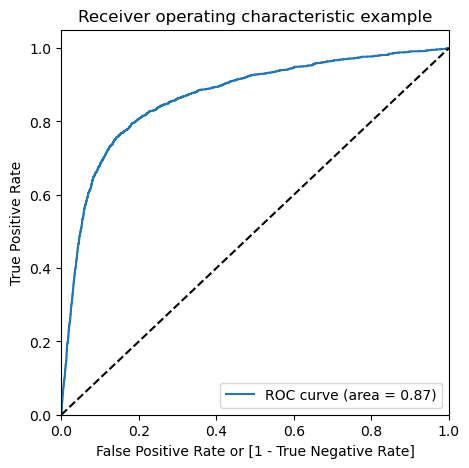

In [142]:
fpr, tpr, thresholds = metrics.roc_curve( y_train_pred_final.Churn, y_train_pred_final.Churn_Prob, drop_intermediate = False )
draw_roc(y_train_pred_final.Churn, y_train_pred_final.Churn_Prob)

### Step 9: Finding Optimal Cutoff Point

Optimal cutoff probability is that prob where we get balanced sensitivity and specificity

In [143]:
# Let's create columns with different probability cutoffs 
numbers = [float(x)/10 for x in range(10)]
for i in numbers:
    y_train_pred_final[i]= y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > i else 0)
y_train_pred_final.head()

,Churn,Churn_Prob,Circle_ID,predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9
0,0,0.032669,39186,0,1,0,0,0,0,0,0,0,0,0
1,0,0.012362,39833,0,1,0,0,0,0,0,0,0,0,0
2,0,0.055359,38778,0,1,0,0,0,0,0,0,0,0,0
3,0,0.023735,43026,0,1,0,0,0,0,0,0,0,0,0
4,0,0.017990,12271,0,1,0,0,0,0,0,0,0,0,0


In [144]:
# Now let's calculate accuracy sensitivity and specificity for various probability cutoffs.
cutoff_df = pd.DataFrame( columns = ['prob','accuracy','sensi','speci'])

# TP = confusion[1,1] # true positive 
# TN = confusion[0,0] # true negatives
# FP = confusion[0,1] # false positives
# FN = confusion[1,0] # false negatives

num = [0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
for i in num:
    cm1 = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final[i] )
    total1=sum(sum(cm1))
    accuracy = (cm1[0,0]+cm1[1,1])/total1
    
    speci = cm1[0,0]/(cm1[0,0]+cm1[0,1])
    sensi = cm1[1,1]/(cm1[1,0]+cm1[1,1])
    cutoff_df.loc[i] =[ i ,accuracy,sensi,speci]
print(cutoff_df)

     prob  accuracy     sensi     speci
0.0   0.0  0.080524  1.000000  0.000000
0.1   0.1  0.812429  0.796570  0.813817
0.2   0.2  0.894524  0.649320  0.915998
0.3   0.3  0.916905  0.464814  0.956497
0.4   0.4  0.920381  0.241277  0.979854
0.5   0.5  0.920048  0.098167  0.992024
0.6   0.6  0.920429  0.038439  0.997669
0.7   0.7  0.919952  0.016558  0.999068
0.8   0.8  0.919762  0.005914  0.999793
0.9   0.9  0.919667  0.002957  0.999948


#### From the table, 0.5 is the optimum point to take it as a cutoff probability as it fallows our accuracy,sensitivity,specificity value that we got above in our Training Model as output.
* Accuracy: 0.920047619047619

* Sensitivity 0.09816676522767594

* Specificity 0.9920244445595319

In [145]:
y_train_pred_final['final_predicted'] = y_train_pred_final.Churn_Prob.map( lambda x: 1 if x > 0.5 else 0)

y_train_pred_final.head()

,Churn,Churn_Prob,Circle_ID,predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,final_predicted
0,0,0.032669,39186,0,1,0,0,0,0,0,0,0,0,0,0
1,0,0.012362,39833,0,1,0,0,0,0,0,0,0,0,0,0
2,0,0.055359,38778,0,1,0,0,0,0,0,0,0,0,0,0
3,0,0.023735,43026,0,1,0,0,0,0,0,0,0,0,0,0
4,0,0.017990,12271,0,1,0,0,0,0,0,0,0,0,0,0


In [146]:
# Let's check the overall accuracy.
metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.final_predicted)

0.920047619047619

In [147]:
confusion_matrix2 = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final.final_predicted )
confusion_matrix2

array([[19155,   154],
       [ 1525,   166]], dtype=int64)

In [148]:
TP = confusion_matrix2[1,1] # true positive 
TN = confusion_matrix2[0,0] # true negatives
FP = confusion_matrix2[0,1] # false positives
FN = confusion_matrix2[1,0] # false negatives

# Let's see the sensitivity of our logistic regression model
print('Sensitivity' , TP / float(TP+FN))

# Let us calculate specificity
print('Specificity', TN / float(TN+FP))

# Calculate false postive rate - predicting churn when customer does not have churned
print('false postive rate', FP/ float(TN+FP))

# positive predictive value 
print ('positive predictive value', TP / float(TP+FP))

# Negative predictive value
print ('Negative predictive value',TN / float(TN+ FN))

Sensitivity 0.09816676522767594
Specificity 0.9920244445595319
false postive rate 0.007975555440468176
positive predictive value 0.51875
Negative predictive value 0.9262572533849129


##### Precision and Recall
* Percision TP / TP + FP
* Recall TP / TP + FN

In [149]:
print('Precision Score',precision_score(y_train_pred_final.Churn, y_train_pred_final.predicted))
print('Recall_score',recall_score(y_train_pred_final.Churn, y_train_pred_final.predicted))

Precision Score 0.51875
Recall_score 0.09816676522767594


In [150]:
### Checking the Churn Rate
churn = (sum(telData['churn'])/len(telData['churn'].index))*100
churn

8.136395453484884

We have almost 8% churn rate

## Step 10: Making predictions on the test set

In [151]:
X_test = X_test[col]
X_test.head()

,onnet_mou_8,offnet_mou_8,roam_ic_mou_8,roam_og_mou_8,loc_ic_mou_8,std_ic_mou_8,spl_ic_mou_8,total_rech_num_8,last_day_rch_amt_8,vol_2g_mb_8,...,avg_roam_og_mou_av67,avg_loc_og_mou_av67,avg_std_og_mou_av67,avg_max_rech_amt_av67,avg_vol_2g_mb_av67,avg_arpu_2g_av67,avg_monthly_2g_av67,avg_sachet_2g_av67,avg_sachet_3g_av67,aon_mon
0,0.000743,0.001596,0.000000,0.000000,0.008659,0.000611,0.0,0.020408,0.032367,0.000000,...,0.000000,0.004634,0.001637,0.040921,0.000000,0.001706,0.000000,0.000000,0.000000,0.117604
1,0.000880,0.000254,0.001166,0.000948,0.001477,0.002704,0.0,0.035714,0.000000,0.015708,...,0.002697,0.001064,0.000621,0.008336,0.040097,0.006936,0.000000,0.148649,0.000000,0.133060
2,0.021656,0.062145,0.000000,0.000000,0.076430,0.007992,0.0,0.040816,0.029220,0.000000,...,0.000000,0.146384,0.014680,0.046529,0.000086,0.032973,0.000000,0.000000,0.055556,0.011833
3,0.010755,0.015895,0.000000,0.000000,0.033921,0.000962,0.0,0.117347,0.006743,0.000000,...,0.000000,0.039502,0.013382,0.015156,0.000000,0.001706,0.000000,0.000000,0.000000,0.249215
4,0.004409,0.000376,0.011848,0.007463,0.004034,0.000000,0.0,0.010204,0.000000,0.000000,...,0.000000,0.017396,0.060527,0.046681,0.022851,0.001706,0.285714,0.027027,0.000000,0.334219


In [152]:
X_test_sm = sm.add_constant(X_test)

#### Making predictions on the test set

In [153]:
y_test_pred = res.predict(X_test_sm)
y_test_pred[:10]

0    0.123958
1    0.081345
2    0.070893
3    0.015908
4    0.326736
5    0.014099
6    0.020244
7    0.011010
8    0.022792
9    0.080328
dtype: float64

In [154]:
# Converting y_pred to a dataframe which is an array
y_pred_1 = pd.DataFrame(y_test_pred)
# Let's see the head
y_pred_1.head()

,0
0,0.123958
1,0.081345
2,0.070893
3,0.015908
4,0.326736


In [155]:
# Converting y_test to dataframe
y_test_df = pd.DataFrame(y_test)

# Putting CustID to index
y_test_df['Circle_ID'] = y_test_df.index

In [156]:
# Removing index for both dataframes to append them side by side 
y_pred_1.reset_index(drop=True, inplace=True)
y_test_df.reset_index(drop=True, inplace=True)

In [157]:
# Appending y_test_df and y_pred_1
y_pred_final = pd.concat([y_test_df, y_pred_1],axis=1)
y_pred_final.head()

# Renaming the column 
y_pred_final= y_pred_final.rename(columns={ 0 : 'Churn_Prob'})
# Let's see the head of y_pred_final
y_pred_final.head()

,churn,Circle_ID,Churn_Prob
0,1,20296,0.123958
1,1,8279,0.081345
2,0,72269,0.070893
3,0,65602,0.015908
4,1,42758,0.326736


In [158]:
y_pred_final['final_predicted'] = y_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

In [159]:
y_pred_final.head()

,churn,Circle_ID,Churn_Prob,final_predicted
0,1,20296,0.123958,0
1,1,8279,0.081345,0
2,0,72269,0.070893,0
3,0,65602,0.015908,0
4,1,42758,0.326736,0


In [160]:
# Let's check the overall accuracy.
metrics.accuracy_score(y_pred_final.churn, y_pred_final.final_predicted)

0.9196755916009333

In [161]:
confusion_matrix3 = metrics.confusion_matrix(y_pred_final.churn, y_pred_final.final_predicted )
confusion_matrix3

array([[8187,   64],
       [ 659,   91]], dtype=int64)

In [162]:
TP = confusion_matrix3[1,1] # true positive 
TN = confusion_matrix3[0,0] # true negatives
FP = confusion_matrix3[0,1] # false positives
FN = confusion_matrix3[1,0] # false negatives

# Let's see the sensitivity of our logistic regression model
print('Sensitivity' , TP / float(TP+FN))

# Let us calculate specificity
print('Specificity', TN / float(TN+FP))

# Calculate false postive rate - predicting churn when customer does not have churned
print('false postive rate', FP/ float(TN+FP))

# positive predictive value 
print ('positive predictive value', TP / float(TP+FP))

# Negative predictive value
print ('Negative predictive value',TN / float(TN+ FN))

Sensitivity 0.12133333333333333
Specificity 0.9922433644406738
false postive rate 0.007756635559326142
positive predictive value 0.5870967741935483
Negative predictive value 0.9255030522269952


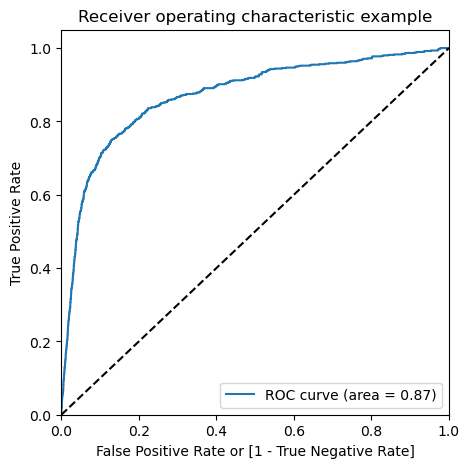

In [163]:
# ROC curve for the test dataset
fpr, tpr, thresholds = metrics.roc_curve(y_pred_final.churn,y_pred_final.Churn_Prob, drop_intermediate = False )
# Plotting the curve for the obtained metrics
draw_roc(y_pred_final.churn, y_pred_final.Churn_Prob)

 **The AUC score for train dataset is 0.90 and the test dataset is 0.87.<br> This model can be considered as a good model.** 

## Step: 11 PCA

#### 11.1 Train_test_split before doing PCA

In [164]:
# Assuming you have your feature matrix X and target variable y
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, train_size=0.7, random_state=1)

##### 11.2 Class Imbalance Using SMOTE Technique To make it Balanced and then Scaled

In [165]:
from sklearn.decomposition import PCA
# Instantiate the SMOTE resampler
smote = SMOTE()

# Apply SMOTE to oversample the minority class
X_resampled, y_resampled = smote.fit_resample(X, y)

# Perform feature scaling
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_resampled)
X_test_scaled = scaler.transform(X_resampled)

print('X_train',X_train_scaled.shape)
print('y_train',y_resampled.shape)

X_train (55120, 75)
y_train (55120,)


In [166]:
# Apply PCA
pca = PCA(random_state=2) 

# applying PCA on train data
pca.fit(X_train_scaled)

# applying PCA on training data
X_tr_pca = pca.fit_transform(X_train_scaled)
print(X_tr_pca.shape)

# applying PCA on testing data
X_test_pca = pca.transform(X_test_scaled)
print(X_test_pca.shape)

(55120, 75)
(55120, 75)


In [167]:
#Viewing the PCA components
pca.components_

array([[ 1.62563323e-03, -1.10779367e-02, -7.52005861e-03, ...,
         6.75940522e-01,  1.31235334e-02,  2.25463303e-02],
       [ 1.32741908e-02,  1.39738715e-02,  1.25417297e-02, ...,
        -7.06590166e-01, -1.03608681e-02,  1.44867085e-01],
       [ 6.53893974e-03, -5.92083137e-03,  3.67945919e-03, ...,
         8.26775582e-02, -6.79138050e-03,  9.72910216e-01],
       ...,
       [-4.67358934e-03, -3.91301018e-01, -5.09241978e-01, ...,
         7.32993538e-06, -2.67879890e-04,  4.75941619e-05],
       [ 3.76081441e-15,  6.33351930e-15,  7.61898227e-15, ...,
        -8.04573352e-18, -1.53461976e-17,  1.95620528e-17],
       [ 0.00000000e+00, -4.94274978e-15, -5.52081421e-15, ...,
        -8.90987253e-18, -9.49590633e-17, -8.32626253e-18]])

## Step 12 .Logistic Regression with PCA

In [168]:
# logistic Regression using PCA
log_pca = LogisticRegression()
log_pca.fit(X_tr_pca, y_resampled)

# making the predictions
y_pred = log_pca.predict(X_test_pca)

# converting the prediction into a dataframe
y_pred_df = pd.DataFrame(y_pred)
print("Dimension of y_pred_df:", y_pred_df.shape)

Dimension of y_pred_df: (55120, 1)


In [169]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score


# Checking the Confusion matrix
print("Confusion Matirx ",confusion_matrix(y_resampled,y_pred))

# Checking the Accuracy of the Predicted model.
print("Accuracy of the logistic regression model with PCA: ",accuracy_score(y_resampled,y_pred))

Confusion Matirx  [[22322  5238]
 [ 3959 23601]]
Accuracy of the logistic regression model with PCA:  0.8331458635703919


### 12.1 Hyper turning to increse the accuracy of our PCA model with Number of components selection

<BarContainer object of 75 artists>

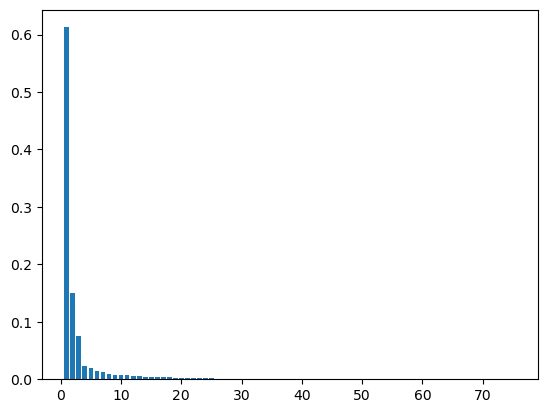

In [170]:
plt.bar(range(1,len(pca.explained_variance_ratio_)+1), pca.explained_variance_ratio_)

In [171]:
np.cumsum(np.round(pca.explained_variance_ratio_, decimals=4)*100)
# 10 columns explains 90% of the variance, lets apply PCA with 10 components

array([ 61.27,  76.27,  83.86,  86.14,  88.03,  89.49,  90.83,  91.72,
        92.47,  93.18,  93.86,  94.51,  95.05,  95.47,  95.85,  96.21,
        96.56,  96.88,  97.16,  97.44,  97.68,  97.85,  98.01,  98.16,
        98.31,  98.43,  98.53,  98.63,  98.73,  98.82,  98.91,  99.  ,
        99.08,  99.16,  99.22,  99.28,  99.34,  99.39,  99.44,  99.48,
        99.52,  99.56,  99.6 ,  99.64,  99.68,  99.71,  99.74,  99.77,
        99.8 ,  99.82,  99.84,  99.86,  99.88,  99.9 ,  99.92,  99.93,
        99.94,  99.95,  99.96,  99.97,  99.98,  99.99, 100.  , 100.01,
       100.01, 100.01, 100.01, 100.01, 100.01, 100.01, 100.01, 100.01,
       100.01, 100.01, 100.01])

### 12.2 Scree plot to check the variance explained by different PCAs

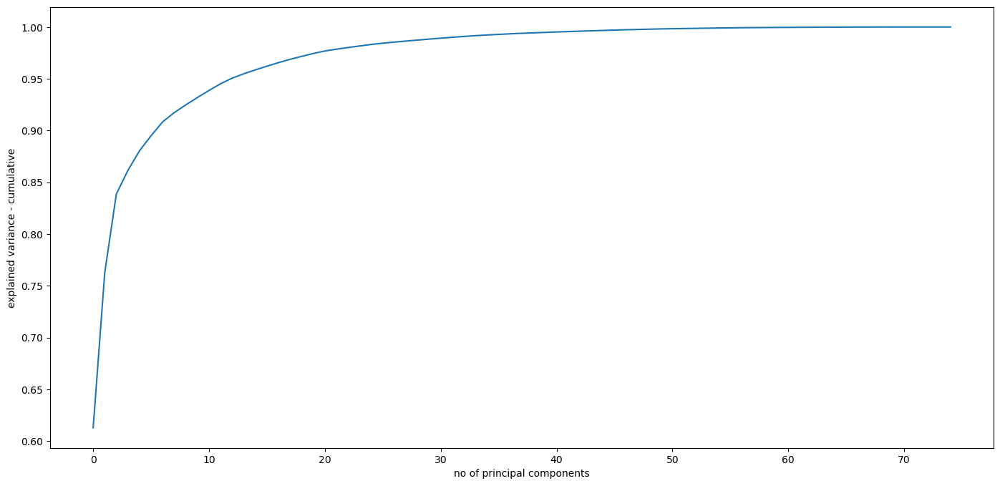

In [172]:
# scree plot to check the variance explained by different PCAs
fig = plt.figure(figsize = (17,8))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('no of principal components')
plt.ylabel('explained variance - cumulative')
plt.show()

### 12. 3 Checking with 10 components

In [173]:
# PCA with 10 components
pca_10 = PCA(n_components=10,random_state=42)
df_tr_pca_10 = pca_10.fit_transform(X_train_scaled)
print(df_tr_pca_10.shape)
df_test_pca_10 = pca_10.transform(X_test)
print(df_test_pca_10.shape)

(55120, 10)
(9001, 10)


In [174]:
# Let's run the model using the selected variables
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
lr_pca1 = LogisticRegression(C=1e9)
lr_pca1.fit(df_tr_pca_10, y_resampled)

# Predicted probabilities
y_pred10 = lr_pca1.predict(df_test_pca_10)

In [175]:
# Converting y_pred to a dataframe which is an array
df_y_pred = pd.DataFrame(df_tr_pca_10)
df_y_pred.head()
df = pd.DataFrame(df_tr_pca_10, columns=["PC1", "PC2","PC3","PC4","PC5","PC6","PC7","PC8","PC9","PC10"])
col = list(df.columns)
df.head(10)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10
0,0.894119,0.092405,-0.041894,0.157011,0.037045,0.010048,-0.064904,-0.047955,-0.003839,-0.062897
1,-0.522693,0.134256,-0.016926,0.141780,0.027954,-0.102019,-0.011448,0.135424,-0.010232,0.171121
2,0.538188,0.415682,-0.255618,-0.033992,-0.066938,-0.023772,0.042849,-0.010083,0.030611,-0.014877
3,-0.537994,0.124227,-0.094197,-0.025207,0.001078,0.033864,-0.007619,0.027998,-0.063604,-0.026276
4,0.547051,0.430550,-0.173857,0.092521,-0.005961,-0.093124,-0.055080,-0.032487,0.020320,-0.087154
5,0.992817,0.047857,0.047829,0.248994,0.960432,-0.281853,-0.107981,-0.108796,-0.035249,0.148372
6,-0.532416,0.131957,0.012752,-0.026574,-0.008915,-0.016306,-0.006366,-0.050251,0.036485,-0.004750
7,-0.521344,0.158169,0.235169,-0.004961,-0.024514,-0.101354,-0.005279,-0.017563,0.002474,-0.005748
8,-0.539674,0.148668,0.050832,0.021437,0.028310,0.083308,0.008741,0.049301,0.108147,-0.001251
9,-0.179215,-0.245578,-0.045433,-0.086500,-0.039232,-0.006162,-0.052919,0.132053,0.011681,0.025121


In [176]:
df_final = pd.concat([df, y], axis=1)

In [177]:
df_final['churn'] = df_final['churn'].replace({1.0 : 1 , np.NaN : 0 , 0.0: 0})
df_final['churn'] = df_final['churn'].astype(int)

In [178]:
df_final.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,churn
0,0.894119,0.092405,-0.041894,0.157011,0.037045,0.010048,-0.064904,-0.047955,-0.003839,-0.062897,1
1,-0.522693,0.134256,-0.016926,0.141780,0.027954,-0.102019,-0.011448,0.135424,-0.010232,0.171121,0
2,0.538188,0.415682,-0.255618,-0.033992,-0.066938,-0.023772,0.042849,-0.010083,0.030611,-0.014877,0
3,-0.537994,0.124227,-0.094197,-0.025207,0.001078,0.033864,-0.007619,0.027998,-0.063604,-0.026276,0
4,0.547051,0.430550,-0.173857,0.092521,-0.005961,-0.093124,-0.055080,-0.032487,0.020320,-0.087154,0


# Step 13 .  Building PairPlot with 10 PCA Components

<Figure size 2500x500 with 0 Axes>

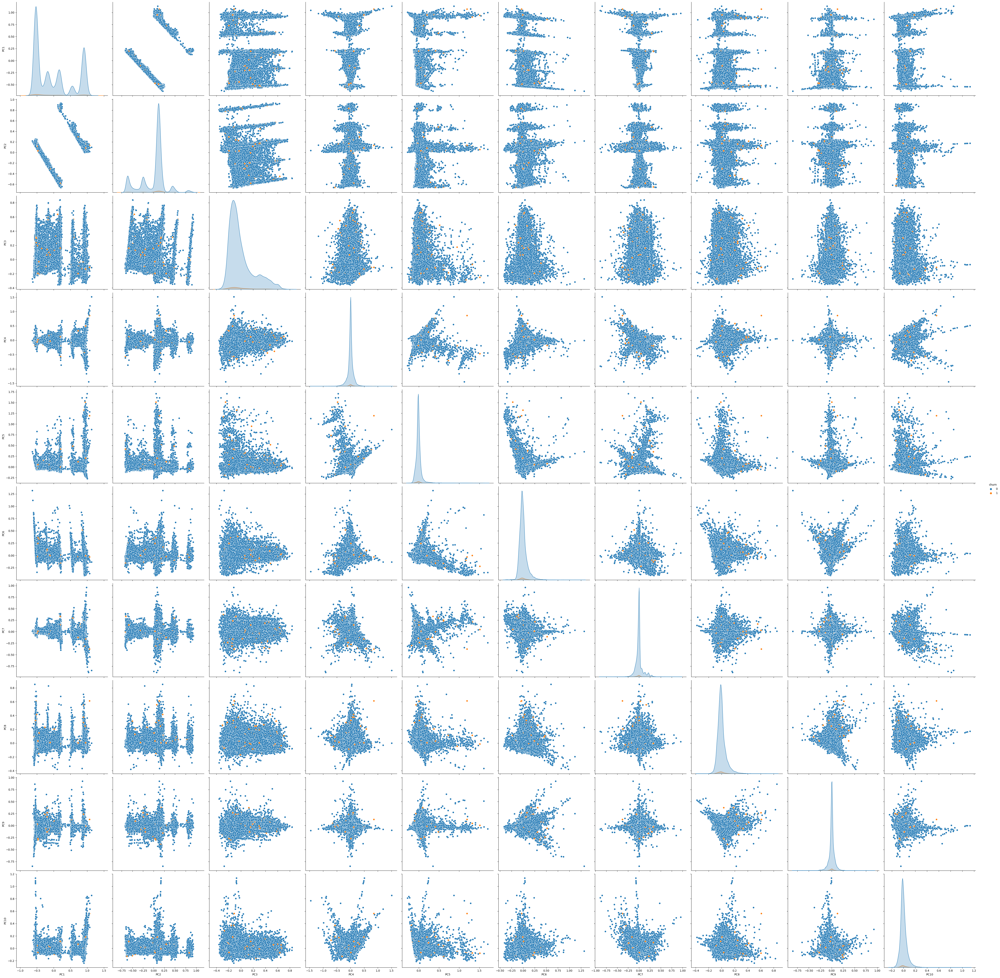

In [179]:
# pairplot with all 10 components with respect to churn. But it takes time lots of time.But graph shows correctly.
plt.figure(figsize=(25,5))
sns.pairplot(data=df_final, x_vars=["PC1","PC2","PC3","PC4","PC5","PC6","PC7","PC8","PC9","PC10"], hue = "churn", size=5)
plt.show()

#### As we can all 10 components were not multicolliner ,as well as not forming any specific pattern ,they are well distributed.Overall we got a good PCA model

## Step 14.  Accuracy and other Metrics Scores for using PCA with Logistic Regression

In [180]:
print("Accuracy with 10 PCAs: ",accuracy_score(y_test,y_pred10))

Accuracy with 10 PCAs:  0.9185646039328963


In [181]:
confusion_matrix4 = confusion_matrix(y_test,y_pred10)
print(confusion_matrix(y_test,y_pred10))

[[8255   17]
 [ 716   13]]


In [182]:
TP = confusion_matrix4[1,1] # true positive 
TN = confusion_matrix4[0,0] # true negatives
FP = confusion_matrix4[0,1] # false positives
FN = confusion_matrix4[1,0] # false negatives

# Let's see the sensitivity of our logistic regression model
print('Sensitivity' , TP / float(TP+FN))

# Let us calculate specificity
print('Specificity', TN / float(TN+FP))

# Calculate false postive rate - predicting churn when customer does not have churned
print('false postive rate', FP/ float(TN+FP))

# positive predictive value 
print ('positive predictive value', TP / float(TP+FP))

# Negative predictive value
print ('Negative predictive value',TN / float(TN+ FN))

print('Precision Score',precision_score(y_test,y_pred10))

print('Recall_score',recall_score(y_test,y_pred10))

Sensitivity 0.01783264746227709
Specificity 0.9979448742746615
false postive rate 0.002055125725338491
positive predictive value 0.43333333333333335
Negative predictive value 0.9201872700925203
Precision Score 0.43333333333333335
Recall_score 0.01783264746227709


#### Hence best PCA model for our case study is with 10 components with the accuracy of 92%.

## Step 15 : Key Findings:

### 15.1. List Of Users who can Churn.

In [183]:
df_final['churn'].value_counts()

churn
0    66172
1     2441
Name: count, dtype: int64

In [184]:
churn_list = df_final['churn']

In [185]:
churn_list.to_excel("churn_list.xlsx",index=False)

In [186]:
churn = pd.read_excel("churn_list.xlsx")
churn.head(10)

,churn
0,1
1,0
2,0
3,0
4,0
5,0
6,0
7,1
8,0
9,0


### 15.2. Comparative Study on Metrics we found on both RFE and PCA using Logictic Regression

##### Logistic Regression using RFE:


#### Training DataSet:

* Accuracy: <b> 0.920047619047619 </b>
    
* Confusion Matrix: <b> array([[19155,   154],
                          [ 1525,   166]], dtype=int64)</b>

* Sensitivity <b> 0.09816676522767594 </b>

* Specificity <b> 0.9920244445595319</b>

* false postive rate  <b> 0.007975555440468176</b>

* positive predictive value  <b>0.51875</b>

* Negative predictive value <b>  0.9262572533849129</b>

* Precision Score <b>  0.51875</b>

* Recall_score <b>  0.09816676522767594</b>

* ROC Curve:- <b>  0.87 and AUC curve = 0.90</b>

#### Predictions On Test DataSet:

* Accuracy  <b> 0.9196755916009333</b>
    
* Confusion Matrix  <b> array([[8187,   64],
                            [ 659,   91]], dtype=int64)</b>

* Sensitivity  <b>  0.12133333333333333</b>

* Specificity  <b> 0.9922433644406738</b>

* false postive rate  <b> 0.007756635559326142</b>

* positive predictive value  <b>  0.5870967741935483</b>

* Negative predictive value  <b> 0.9255030522269952</b>

* ROC Curve  on Test Data  <b> 0.87 same and AUC curve 0.90</b>


### Logistic Regression using PCA:

#### Prediction On 10 Components Selected using PCA Model

* Accuracy with 10 PCAs <b>  0.9176758137984669</b>

* Confusion Matrix <b> [[8246   26]
                     [ 715   14]]</b>

* Sensitivity <b> 0.019204389574759947</b>

* Specificity <b> 0.9968568665377177</b>

* false postive rate <b> 0.0031431334622823983</b>

* positive predictive value <b> 0.35</b>

* Negative predictive value <b> 0.9202097980136146</b>

* Precision Score <b> 0.35 </b>

* Recall_score <b> 0.019204389574759947 </b>

## 16. Conclusion or Insights On Model.

#### Reasons why Customer/User can Churn as per Business Objective:
* Average revenue per user more, those are likely to churn if they are not happy with the network.
* local calls minutes of usage has also has impact on churn .
* Large difference between recharge amount between 6th and 7th month, also impact churn.
* Users who are using more Roaminng in Outgoing and Incoming calls, are likely to churn.Compnay can focus on them too.

Top 10 most important predictors that affects the ratio are:
1. fb_user_8	
2. avg_max_rech_amt_av67	
3. sachet_2g_8	
4. total_rech_num_8	
5. avg_sachet_2g_av67	
6. offnet_mou_8	
7. avg_std_og_mou_av67	
8. avg_roam_og_mou_av67	
9. avg_roam_ic_mou_av67	
10. avg_loc_og_mou_av67	
* As we can see all 10 components were not multicolliner ,as well as not forming any specific pattern ,they are well distributed.Overall we got a good PCA model.If we check from 10 to 33 components we get the same accuracy as we go above then accuracy starts decreasing.
We can see most of the top predictors are from the action phase, as the drop in engagement is prominent in that phase.

#### EDA INSIGHTS:

* Max Users likes to churn in between 0-6 months were as very less user continue with the services 5 Years and above.On an average users probability of churning in between 6 months to 5 years are almost same.
* Avg Outgoing Calls & calls on romaning for 6 & 7th months are positively correlated with churn. 
* Avg Revenue, No. Of Recharge for 8th month and fb_user of 8 month has negative correlation with churn.
* Distribution of Max Recharge Amount by churn for 8 month are Churned more than not churn.
* Average Max recharge amount for 6 & 7 month are Churned more than not churn.
* Around 3500 users uses a particular network for atleast 20 months ,then gradually the its starts decreasing ,Well only 500 users sticks to a network for about 120 months i,e 5 years approx.
    